# Keyence profile data analysis

- with example data collected with the Keyence KVX-3000 optical profilometer at the UMN CharFac
- the example sample is a moderately polished Durango apatite crystal mounted in epoxy
- the features of interests are laser drill pits made by a 257 nm fs-laser

In [7]:
import numpy as np
from scipy.ndimage import gaussian_filter
import matplotlib.pyplot as plt
import pandas as pd
import struct
import zipfile
import io
from collections import namedtuple
import copy

import plotly.graph_objects as go
import plotly.io as pio
pio.renderers.default = 'notebook'

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# handy functions

In [ ]:
def parse_vk6_file(filename):
    '''
    function to parse a VK6 file and return the data in a dictionary
        this function is converted from the Gwyddion software c source code
        for details, check out the Gwyddion official website: https://gwyddion.net/

    Parameters:
    filename: str, the path to the VK6 file

    Returns:
    result: dict, a dictionary containing:
            a Vk4 file object
            a Vk4 measurement condition object
            a VK6 measurement condition object
            a Vk6 image data object
    '''
    MAGIC6 = b'VK6'
    MAGICBMP = b'BM'
    KEYENCE6_HEADER_SIZE = 7
    BMP_HEADER_SIZE = 14 + 40  # NT/3.1 BMP header size

    with open(filename, 'rb') as f:
        buffer = f.read()
    # Check if the file starts with the VK6 magic number
    if not buffer.startswith(MAGIC6):
        raise ValueError("Not a valid VK6 file")

    # Check if the BMP header is present
    bmp_header_offset = KEYENCE6_HEADER_SIZE
    if not buffer[bmp_header_offset:bmp_header_offset + len(MAGICBMP)] == MAGICBMP:
        raise ValueError("BMP header not found in VK6 file")

    # Extract the BMP size from the VK6 miniheader
    vk6_skip = struct.unpack('<I', buffer[len(MAGIC6):len(MAGIC6) + 4])[0]

    # Extract the BMP size from the BMP header
    bmp_size = struct.unpack('<I', buffer[bmp_header_offset + 2:bmp_header_offset + 6])[0]
    # print(f"BMP image file size: {bmp_size}")

    # Verify that the VK6 miniheader agrees with the BMP header
    if vk6_skip != bmp_size:
        raise ValueError("VK6 miniheader and BMP header size mismatch")

    # The remaining data after the BMP should be a ZIP archive
    zip_data_offset = KEYENCE6_HEADER_SIZE + bmp_size
    zip_data = buffer[zip_data_offset:]

    # Open the ZIP archive
    with zipfile.ZipFile(io.BytesIO(zip_data)) as zip_file:
        # there should be four files in the ZIP archive
        # print(zip_file.namelist())
        Vk4File = zip_file.open('Vk4File')
        Vk4MeasureCondition = zip_file.open('Vk4MeasureCondition')
        VK6MeasureCondition = zip_file.open('VK6MeasureCondition')
        Vk6ImageData = zip_file.open('Vk6ImageData')
    
    result = {'Vk4File': Vk4File, 
              'Vk4MeasureCondition': Vk4MeasureCondition, 
              'VK6MeasureCondition': VK6MeasureCondition, 
              'Vk6ImageData': Vk6ImageData}

    return result



# extract offsets for data sections of vk4 file
def extract_offsets(in_file):
    '''
    function to extract the offsets for the data sections of a VK4 file
        this code is from Github repo of torkian
        for details, check out the Github website https://github.com/torkian/vk4-python-driver

    Parameters:
    in_file: file object, the VK4 file object

    Returns:
    offsets: dict, a dictionary containing the offsets for the data sections of the VK4 file
    '''

    offsets = dict()
    in_file.seek(12)
    offsets['meas_conds'] = struct.unpack('<I', in_file.read(4))[0]
    offsets['color_peak'] = struct.unpack('<I', in_file.read(4))[0]
    offsets['color_light'] = struct.unpack('<I', in_file.read(4))[0]
    offsets['light'] = struct.unpack('<I', in_file.read(4))[0]
    in_file.seek(8, 1)
    offsets['height'] = struct.unpack('<I', in_file.read(4))[0]
    in_file.seek(8, 1)
    offsets['clr_peak_thumb'] = struct.unpack('<I', in_file.read(4))[0]
    offsets['clr_thumb'] = struct.unpack('<I', in_file.read(4))[0]
    offsets['light_thumb'] = struct.unpack('<I', in_file.read(4))[0]
    offsets['height_thumb'] = struct.unpack('<I', in_file.read(4))[0]
    offsets['assembly_info'] = struct.unpack('<I', in_file.read(4))[0]
    offsets['line_measure'] = struct.unpack('<I', in_file.read(4))[0]
    offsets['line_thickness'] = struct.unpack('<I', in_file.read(4))[0]
    offsets['string_data'] = struct.unpack('<I', in_file.read(4))[0]
    # not sure if reserved is necessary
    offsets['reserved'] = struct.unpack('<I', in_file.read(4))[0]

    return offsets

# extracts metadata and measurement conditions
def extract_measurement_conditions(offset_dict, in_file):
    '''
    function to extract the offsets for the data sections of a VK4 file
        this code is from Github repo of torkian
        for details, check out the Github website https://github.com/torkian/vk4-python-driver

    Parameters:
    offset_dict: dict, a dictionary containing the offsets for the data sections of the VK4 file
    in_file: file object, the VK4 file object

    Returns:
    measurement_conditions: dict, a dictionary containing the measurement conditions of the VK4 file
    '''

    measurement_conditions = dict()
    measurement_conditions['name'] = 'measurement_conditions'
    in_file.seek(offset_dict['meas_conds'])
    measurement_conditions['size'] = struct.unpack('<I', in_file.read(4))[0]
    # file date
    measurement_conditions['year'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['month'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['day'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['hour'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['minute'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['second'] = struct.unpack('<I', in_file.read(4))[0]

    measurement_conditions['diff_from_UTC'] = struct.unpack('<i', in_file.read(4))[0]
    measurement_conditions['img_attributes'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['user_interface_mode'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['color_composite_mode'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['img_layer_number'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['run_mode'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['peak_mode'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['sharpening_level'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['speed'] = struct.unpack('<I', in_file.read(4))[0]
    # distance and pitch are considered in nanometers
    measurement_conditions['distance'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['pitch'] = struct.unpack('<I', in_file.read(4))[0]
    # optical zoom interpreted as float => optical_zoom/10.0
    measurement_conditions['optical_zoom'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['number_of_lines'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['line0_position'] = struct.unpack('<I', in_file.read(4))[0]
    # next 12 bytes 'reserved'
    measurement_conditions['reserved_1'] = []
    for x in range(3):
        measurement_conditions['reserved_1'].append(struct.unpack('<I', in_file.read(4))[0])

    measurement_conditions['lens_magnification'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['PMT_gain_mode'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['PMT_gain'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['PMT_offset'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['ND_filter'] = struct.unpack('<I', in_file.read(4))[0]
    # next 4 bytes 'reserved'
    measurement_conditions['reserved_2'] = struct.unpack('<I', in_file.read(4))[0]
    # image average frequency
    measurement_conditions['persist_count'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['shutter_speed_mode'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['shutter_speed'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['white_balance_mode'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['white_balance_red'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['white_balance_blue'] = struct.unpack('<I', in_file.read(4))[0]
    # multiply camera_gain by 6 to get camera gain in dB
    measurement_conditions['camera_gain'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['plane_compensation'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['xy_length_unit'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['z_length_unit'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['xy_decimal_place'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['z_decimal_place'] = struct.unpack('<I', in_file.read(4))[0]
    # the following three values are considered in picometers
    measurement_conditions['x_length_per_pixel'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['y_length_per_pixel'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['z_length_per_digit'] = struct.unpack('<I', in_file.read(4))[0]
    # next 20 bytes reserved
    measurement_conditions['reserved_3'] = []
    for x in range(5):
        measurement_conditions['reserved_3'].append(struct.unpack('<I', in_file.read(4))[0])

    measurement_conditions['light_filter_type'] = struct.unpack('<I', in_file.read(4))[0]
    # next 4 bytes reserved
    measurement_conditions['reserved_4'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['gamma_reverse'] = struct.unpack('<I', in_file.read(4))[0]
    # gamma interpreted as float => gamma/100.0
    measurement_conditions['gamma'] = struct.unpack('<I', in_file.read(4))[0]
    # gamma offset interpreted as float => gamma_correction_offset/65536.0
    measurement_conditions['gamma_correction_offset'] = struct.unpack('<I', in_file.read(4))[0]
    # CCD BW offset interpreted as float => CCD_BW_offset/100.0
    measurement_conditions['CCD_BW_offset'] = struct.unpack('<I', in_file.read(4))[0]
    # numerical aperture interpreted as float => num_aperture/1000.0
    measurement_conditions['num_aperture'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['head_type'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['PMT_gain_2'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['omit_color_img'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['lens_ID'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['light_lut_mode'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['light_lut_in0'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['light_lut_out0'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['light_lut_in1'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['light_lut_out1'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['light_lut_in2'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['light_lut_out2'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['light_lut_in3'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['light_lut_out3'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['light_lut_in4'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['light_lut_out4'] = struct.unpack('<I', in_file.read(4))[0]
    # upper and lower position considered in nanometers
    measurement_conditions['upper_position'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['lower_position'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['light_effective_bit_depth'] = struct.unpack('<I', in_file.read(4))[0]
    measurement_conditions['height_effective_bit_depth'] = struct.unpack('<I', in_file.read(4))[0]

    return measurement_conditions

# color peak and color + light data extracted with extract_color_data
def extract_color_data(offset_dict, color_type, in_file):
    '''
    function to extract the offsets for the data sections of a VK4 file
        this code is from Github repo of torkian
        for details, check out the Github website https://github.com/torkian/vk4-python-driver
    
    Parameters:
    offset_dict: dict, a dictionary containing the offsets for the data sections of the VK4 file
    color_type: str, the type of color data, must be 'peak' or 'light'
    in_file: file object, the VK4 file object

    Returns:
    rgb_color_data: dict, a dictionary containing the color data of the VK4 file
    '''

    rgb_types = {'peak': 'color_peak', 'light': 'color_light'}
    rgb_color_data = dict()
    rgb_color_data['name'] = 'RGB ' + color_type
    in_file.seek(offset_dict[rgb_types[color_type]])

    rgb_color_data['width'] = struct.unpack('<I', in_file.read(4))[0]
    rgb_color_data['height'] = struct.unpack('<I', in_file.read(4))[0]
    rgb_color_data['bit_depth'] = struct.unpack('<I', in_file.read(4))[0]
    rgb_color_data['compression'] = struct.unpack('<I', in_file.read(4))[0]
    rgb_color_data['data_byte_size'] = struct.unpack('<I', in_file.read(4))[0]

    rgb_color_arr = np.zeros(((rgb_color_data['width'] * rgb_color_data['height']),
                              (rgb_color_data['bit_depth'] // 8)), dtype=np.uint8)

    i = 0
    for val in range(rgb_color_data['width'] * rgb_color_data['height']):
        rgb = []
        for channel in range(3):
            rgb.append(ord(in_file.read(1)))
        rgb_color_arr[i] = rgb
        i = i + 1

    rgb_color_data['data'] = rgb_color_arr

    return rgb_color_data


# light and height data extracted with extract_img_data
def extract_img_data(offset_dict, d_type, in_file):
    '''
    function to extract the offsets for the data sections of a VK4 file
        this code is from Github repo of torkian
        for details, check out the Github website https://github.com/torkian/vk4-python-driver
    
    Parameters:
    offset_dict: dict, a dictionary containing the offsets for the data sections of the VK4 file
    d_type: str, the type of image data, must be 'height' or 'light'
    in_file: file object, the VK4 file object

    Returns:
    data: dict, a dictionary containing the image data of the VK4 file
    '''

    data_types = {'height': ('height', np.uint32, '<I', 4),
                  'light': ('light', np.uint16, '<H', 2)}
    data = dict()
    data['name'] = d_type.capitalize()
    in_file.seek(offset_dict[data_types[d_type][0]])
    data['width'] = struct.unpack('<I', in_file.read(4))[0]
    data['height'] = struct.unpack('<I', in_file.read(4))[0]
    data['bit_depth'] = struct.unpack('<I', in_file.read(4))[0]
    data['compression'] = struct.unpack('<I', in_file.read(4))[0]
    data['data_byte_size'] = struct.unpack('<I', in_file.read(4))[0]
    data['palette_range_min'] = struct.unpack('<I', in_file.read(4))[0]
    data['palette_range_max'] = struct.unpack('<I', in_file.read(4))[0]
    # The palette section of the hexdump is 768 bytes long has 256 3-byte
    # repeats, for now I will store them as a 1d array of uint8 values
    palette = np.zeros(768, dtype=np.uint8)

    i = 0
    for val in range(768):
        palette[i] = ord(in_file.read(1))
        i = i+1
    data['palette'] = palette

    array = np.zeros((data['width']*data['height']), dtype=data_types[d_type][1])
    int_type = data_types[d_type][2]
    bytesize = data_types[d_type][3]
    i = 0
    for val in range(data['width']*data['height']):
        # array[i] = data_types[d_type][2](in_file)
        array[i] = struct.unpack(int_type, in_file.read(bytesize))[0]
        i = i + 1
    data['data'] = array

    return data

def parse_vk4_file(Vk4File):
    '''
    a wrapper function for parsing a VK4 file and returning the data in a dictionary
        a specific step in this function is to calibrate the units of the x, y, and z axes
        the calibration is done by multiplying the pixel values by the x_length_per_pixel, y_length_per_pixel, and z_length_per_digit values
        which are recorded in the metadata of the VK4 file

    Parameters:
    Vk4File: file object, the VK4 file object

    Returns:
    result: dict, a dictionary containing:
            a dictionary of measurement conditions
            a dictionary of color peak data
            a dictionary of color light data
            a dictionary of height image data
            a dictionary of light image data    
    '''
    offset_dict = extract_offsets(Vk4File)

    color_peak_data = extract_color_data(offset_dict, 'peak', Vk4File)
    color_light_data = extract_color_data(offset_dict, 'light', Vk4File)
    img_height_data = extract_img_data(offset_dict, 'height', Vk4File)
    img_light_data = extract_img_data(offset_dict, 'light', Vk4File)
    measurement_conditions = extract_measurement_conditions(offset_dict, Vk4File)

    # append true width and height in µm to dictionary
    measurement_conditions['true_width'] = img_height_data['width']/1e6*measurement_conditions['x_length_per_pixel']
    measurement_conditions['true_height'] = img_height_data['height']/1e6*measurement_conditions['y_length_per_pixel']
    # convert height data to be in µm
    img_height_data['data'] = img_height_data['data']/1e6*measurement_conditions['z_length_per_digit']

    result = {'measurement_conditions': measurement_conditions,
              'color_peak_data': color_peak_data,
              'color_light_data': color_light_data,
              'img_height_data': img_height_data,
              'img_light_data': img_light_data}

    return result

def plot_Vk4_reflected_light(Vk4File, colormap = 'gray', scale='absolute'):
    '''
    function for plotting the reflected light image of a VK4 file
    the function uses the plot_reflected_light function to plot the image

    Parameters:
    Vk4File: dict, a dictionary containing the data of a VK4 file
    colormap: str, the colormap to use for the plot
    scale: str, the scale of the plot, must be 'absolute' or 'pixels'

    Returns:
    ax: matplotlib axis object, the axis object of the plot
    '''

    img_data = Vk4File['img_light_data']
    img_width = img_data['width']
    img_height = img_data['height']
    img_array = img_data['data']

    calibration = Vk4File['measurement_conditions']['x_length_per_pixel']
    img_array = img_array.reshape(img_height, img_width)

    return plot_reflected_light(img_array, img_width, img_height, calibration, colormap, scale)

def plot_reflected_light(img_array, img_width, img_height, calibration= 271217, colormap='gray', scale='absolute'):
    '''
    function for plotting the reflected light image of a VK4 file
    the function uses the plot_reflected_light function to plot the image

    Parameters:
    img_array: np.array, the image data
    img_width: int, the width of the image
    img_height: int, the height of the image
    calibration: int, the calibration value of the image, can be found in the metadata of the VK4 file
    colormap: str, the colormap to use for the plot
    scale: str, the scale of the plot, must be 'absolute' or 'pixels'

    Returns:
    ax: matplotlib axis object, the axis object of the plot
    '''
    assert scale in ['absolute', 'pixels'], 'scale must be either "absolute" or "pixels"'
    fig, ax = plt.subplots()
    ax.imshow(img_array, cmap=colormap)
    if scale == 'absolute':
        ax.set_xticks(np.linspace(0, img_width, 5))
        ax.set_yticks(np.linspace(0, img_height, 5))
        ax.set_xticklabels(np.round(np.linspace(0, img_width*calibration/1e6, 5), 2))
        ax.set_yticklabels(np.round(np.linspace(0, img_height*calibration/1e6, 5), 2))
        ax.set_xlabel('X (µm)', fontsize=12)
        ax.set_ylabel('Y (µm)', fontsize=12)
    else:
        ax.set_xlabel('X (pixels)', fontsize=12)
        ax.set_ylabel('Y (pixels)', fontsize=12)
    ax.set_title('Reflected Light image')

    return ax

def plot_Vk4_height(Vk4File, data_type='original', colormap = 'coolwarm', scale='absolute'):
    '''
    function for plotting the height image of a VK4 file
    the function uses the plot_height_data function to plot the image

    Parameters:
    Vk4File: dict, a dictionary containing the data of a VK4 file
    data_type: str, the type of height data to plot, must be 'original', 'baseplane', 'baseplane_fit', or 'baseplane_subtracted'
    colormap: str, the colormap to use for the plot
    scale: str, the scale of the plot, must be 'absolute' or 'pixels'

    Returns:
    ax: matplotlib axis object, the axis object of the plot
    '''
    if data_type == 'original':
        img_array = Vk4File['img_height_data']['data']
    elif data_type == 'baseplane':
        img_array = Vk4File['baseplane']
    elif data_type == 'baseplane_fit':
        img_array = Vk4File['baseplane_fit']
    elif data_type == 'baseplane_subtracted':
        img_array = Vk4File['baseplane_subtracted']
    else:
        raise ValueError('data_type must be either "original", "baseplane", "baseplane_fit", or "baseplane_subtracted"')
    
    img_width = Vk4File['img_height_data']['width']
    img_height = Vk4File['img_height_data']['height']

    calibration = Vk4File['measurement_conditions']['x_length_per_pixel']
    img_array = img_array.reshape(img_height, img_width)

    return plot_height_data(img_array, img_width, img_height, calibration, colormap, scale)

def plot_height_data(img_array, img_width, img_height, calibration= 271217, colormap = 'coolwarm', scale='absolute'):
    '''
    function for plotting the height image of a VK4 file

    Parameters:
    img_array: np.array, the image data
    img_width: int, the width of the image
    img_height: int, the height of the image
    calibration: int, the calibration value of the image, can be found in the metadata of the VK4 file
    colormap: str, the colormap to use for the plot
    scale: str, the scale of the plot, must be 'absolute' or 'pixels'

    Returns:
    ax: matplotlib axis object, the axis object of
    '''
    assert scale in ['absolute', 'pixels'], 'scale must be either "absolute" or "pixels"'
    fig, ax = plt.subplots()
    ax.imshow(img_array, cmap=colormap)
    if scale == 'absolute':
        ax.set_xticks(np.linspace(0, img_width, 5))
        ax.set_yticks(np.linspace(0, img_height, 5))
        ax.set_xticklabels(np.round(np.linspace(0, img_width*calibration/1e6, 5), 2))
        ax.set_yticklabels(np.round(np.linspace(0, img_height*calibration/1e6, 5), 2))
        ax.set_xlabel('X (µm)', fontsize=12)
        ax.set_ylabel('Y (µm)', fontsize=12)
    else:
        ax.set_xlabel('X (pixels)', fontsize=12)
        ax.set_ylabel('Y (pixels)', fontsize=12)
    ax.set_title('Height image')
    
    return ax

def fit_least_squares_plane(z):
    '''
    function for fitting a plane to the height data of a VK4 file using the least squares method
    
    Parameters:
    z: np.array, the height data of the VK4 file, must be a 2D array

    Returns:
    z_plane: np.array, the plane fit to the height data
    '''
    z_flat = z.flatten()
    x = np.arange(z.shape[1])
    y = np.arange(z.shape[0])
    x, y = np.meshgrid(x, y)
    x = x.flatten()
    y = y.flatten()
    # Create a mask to ignore NaN values in z
    mask = ~np.isnan(z_flat)
    # Apply the mask to filter out NaN values
    x_filtered = x[mask]
    y_filtered = y[mask]
    z_filtered = z_flat[mask]
                        
    X = np.vstack([x_filtered, y_filtered, np.ones_like(x_filtered)]).T
    coefficients, _, _, _ = np.linalg.lstsq(X, z_filtered, rcond=None)
    a, b, c = coefficients
    z_plane = a * x + b * y + c
    return z_plane.reshape(z.shape)

def crop_map(data, x0, x1, y0, y1):
    '''
    function for cropping a 2D map

    Parameters:
    data: np.array, the 2D map to crop
    x0: int, the starting x coordinate of the crop
    x1: int, the ending x coordinate of the crop
    y0: int, the starting y coordinate of the crop
    y1: int, the ending y coordinate of the crop

    Returns:
    data[y0:y1, x0:x1]: np.array, the cropped 2D map
    '''
    return data[y0:y1, x0:x1]

def crop_Vk4File_map(Vk4File, x0=None, x1=None, y0=None, y1=None):
    '''
    function for cropping a VK4 file
        this includes cropping all maps in the VK4 file and updating the width and height of the data
        currently, they are height data, light image data, base plane, base plane fit, and base plane subtracted data
    
    Parameters:
    Vk4File: dict, a dictionary containing the data of a VK4 file
    x0: int, the starting x coordinate of the crop
    x1: int, the ending x coordinate of the crop
    y0: int, the starting y coordinate of the crop
    y1: int, the ending y coordinate of the crop

    Returns:
    Vk4File_copy: dict, a dictionary containing the cropped data of the VK4 file
    '''
    if x0 is None:
        x0 = 0
    if x1 is None:
        x1 = Vk4File['img_height_data']['width']
    if y0 is None:
        y0 = 0
    if y1 is None:
        y1 = Vk4File['img_height_data']['height']

    Vk4File_copy = copy.deepcopy(Vk4File)
    # crop both the height and light data so they stay aligned
    Vk4File_copy['img_height_data']['data'] = crop_map(Vk4File_copy['img_height_data']['data'].reshape(Vk4File_copy['img_height_data']['height'], Vk4File_copy['img_height_data']['width']), x0, x1, y0, y1).flatten()
    Vk4File_copy['img_light_data']['data'] = crop_map(Vk4File_copy['img_light_data']['data'].reshape(Vk4File_copy['img_light_data']['height'], Vk4File_copy['img_light_data']['width']), x0, x1, y0, y1).flatten()
    # crop the base plane, base plane fit, and base plane subtracted data if they exist
    if 'baseplane' in Vk4File_copy:
        Vk4File_copy['baseplane'] = crop_map(Vk4File_copy['baseplane'], x0, x1, y0, y1)
    if 'baseplane_fit' in Vk4File_copy:
        Vk4File_copy['baseplane_fit'] = crop_map(Vk4File_copy['baseplane_fit'], x0, x1, y0, y1)
    if 'baseplane_subtracted' in Vk4File_copy:
        Vk4File_copy['baseplane_subtracted'] = crop_map(Vk4File_copy['baseplane_subtracted'], x0, x1, y0, y1)
    # update the width and height of the data
    Vk4File_copy['img_height_data']['width'] = x1 - x0
    Vk4File_copy['img_height_data']['height'] = y1 - y0
    Vk4File_copy['img_light_data']['width'] = x1 - x0
    Vk4File_copy['img_light_data']['height'] = y1 - y0
    return Vk4File_copy

In [ ]:
depthpro_60um_100E_10_20shots_path = '../data/60um_100E_10-20shots_depthpro.vk6'
depthpro_60um_100E_30_50_shots_path = '../data/60um_100E_30-50shots_depthpro.vk6'
depthpro_60um_100E_70_shots_path = '../data/60um_100E_70shots_depthpro.vk6'
depthpro_60um_100E_90_shots_path = '../data/60um_100E_90shots_depthpro_3.vk6'

depthpro_60um_100E_10_20_shots_Vk6 = parse_vk6_file(depthpro_60um_100E_10_20shots_path)
depthpro_60um_100E_30_50_shots_Vk6 = parse_vk6_file(depthpro_60um_100E_30_50_shots_path)
depthpro_60um_100E_70_shots_Vk6 = parse_vk6_file(depthpro_60um_100E_70_shots_path)
depthpro_60um_100E_90_shots_Vk6 = parse_vk6_file(depthpro_60um_100E_90_shots_path)

depthpro_60um_100E_10_20shots_Vk4 = parse_vk4_file(depthpro_60um_100E_10_20_shots_Vk6['Vk4File'])
depthpro_60um_100E_30_50shots_Vk4 = parse_vk4_file(depthpro_60um_100E_30_50_shots_Vk6['Vk4File'])
depthpro_60um_100E_70_shots_Vk4 = parse_vk4_file(depthpro_60um_100E_70_shots_Vk6['Vk4File'])
depthpro_60um_100E_90_shots_Vk4 = parse_vk4_file(depthpro_60um_100E_90_shots_Vk6['Vk4File'])

In [34]:
# crop the edges
depthpro_60um_100E_70_shots_Vk4_cropped = crop_Vk4File_map(depthpro_60um_100E_70_shots_Vk4, x0=180)
depthpro_60um_100E_90_shots_Vk4_cropped = crop_Vk4File_map(depthpro_60um_100E_90_shots_Vk4, x0=220)

## reflected light image

### 60µm 100% E 10-20 shots

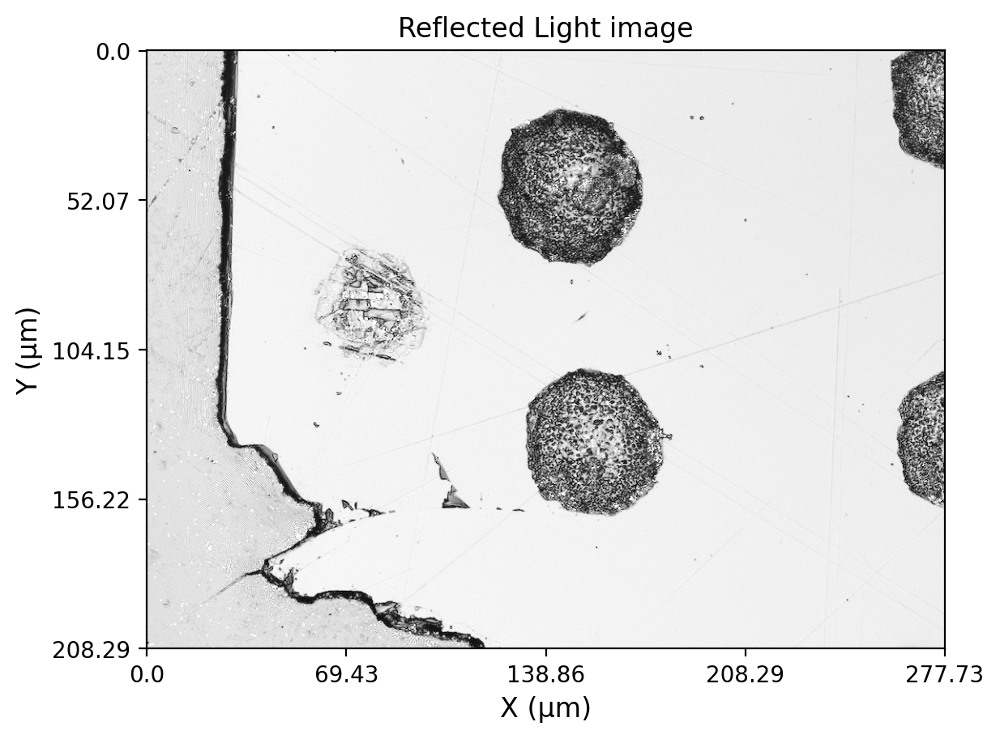

In [11]:
# display the color peak data as an image
ax = plot_Vk4_reflected_light(depthpro_60um_100E_10_20shots_Vk4)

### 60µm 100% E 30-50 shots

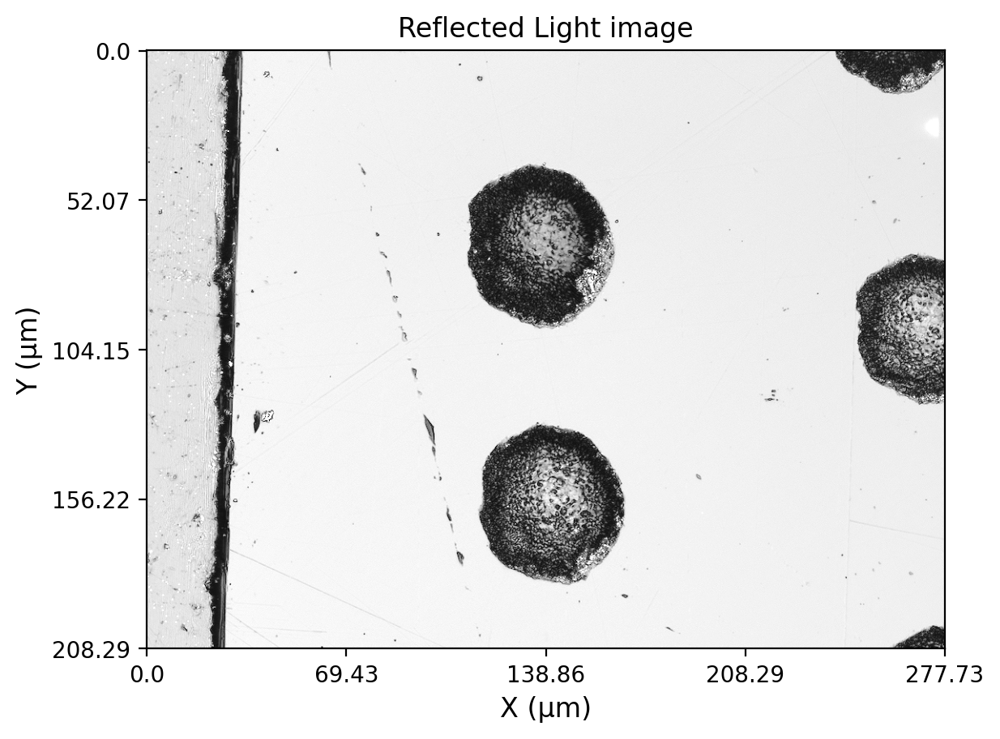

In [12]:
# display the color peak data as an image
ax = plot_Vk4_reflected_light(depthpro_60um_100E_30_50shots_Vk4)

### 60µm 100% E 70 shots

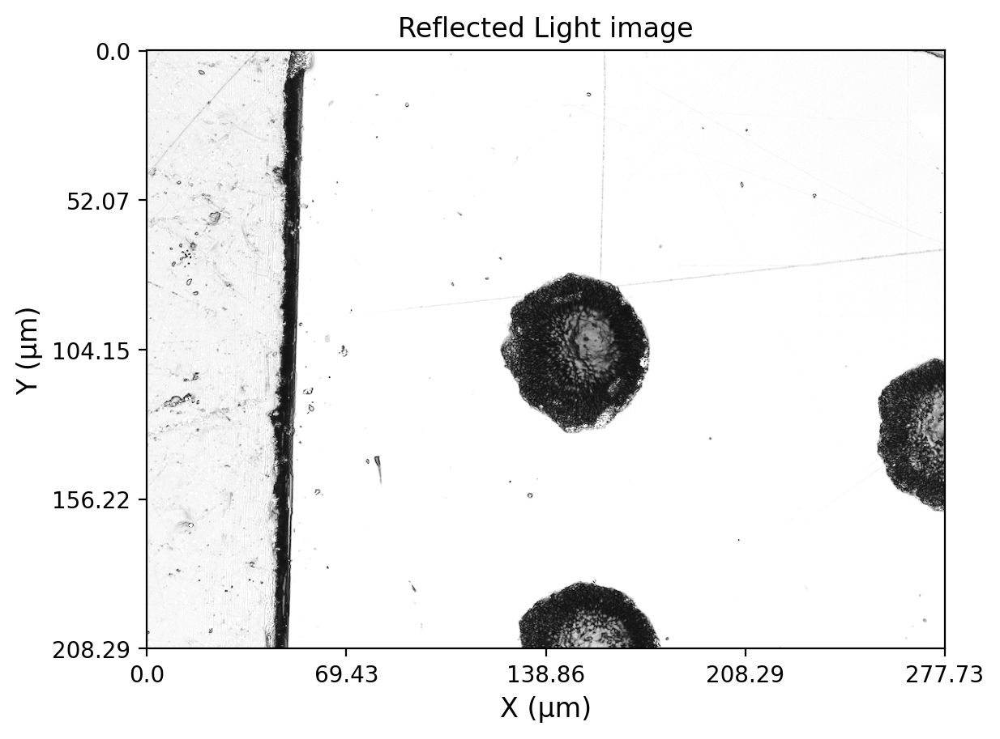

In [30]:
# display the color peak data as an image
ax = plot_Vk4_reflected_light(depthpro_60um_100E_70_shots_Vk4)

### 60µm 100% E 90 shots

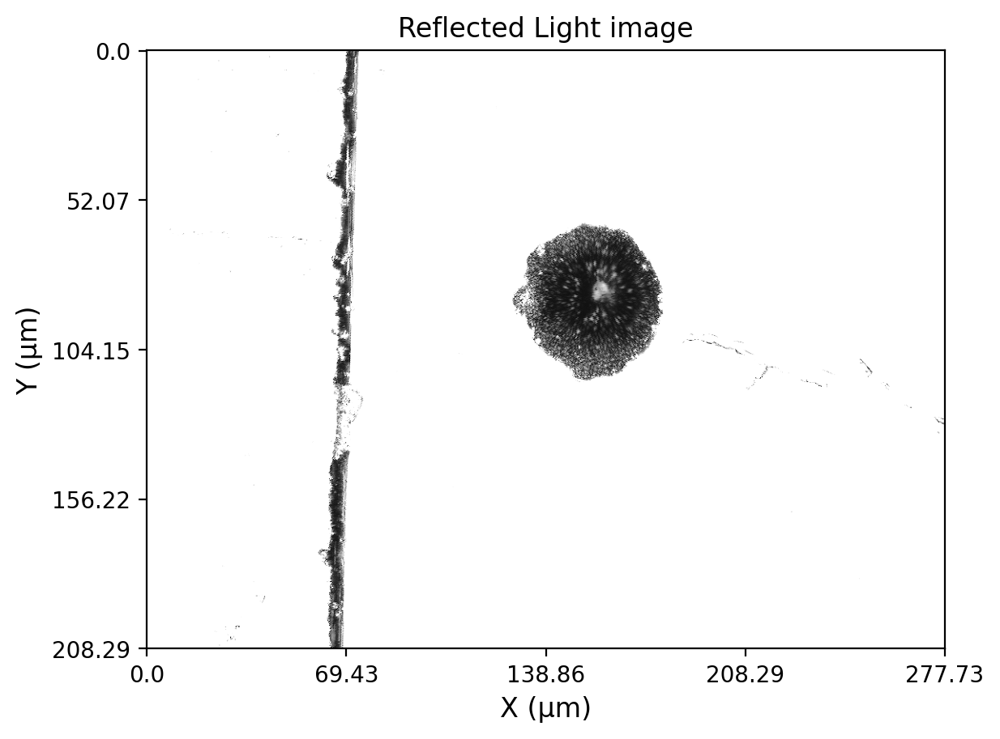

In [14]:
# display the color peak data as an image
ax = plot_Vk4_reflected_light(depthpro_60um_100E_90_shots_Vk4)

## depth profile image

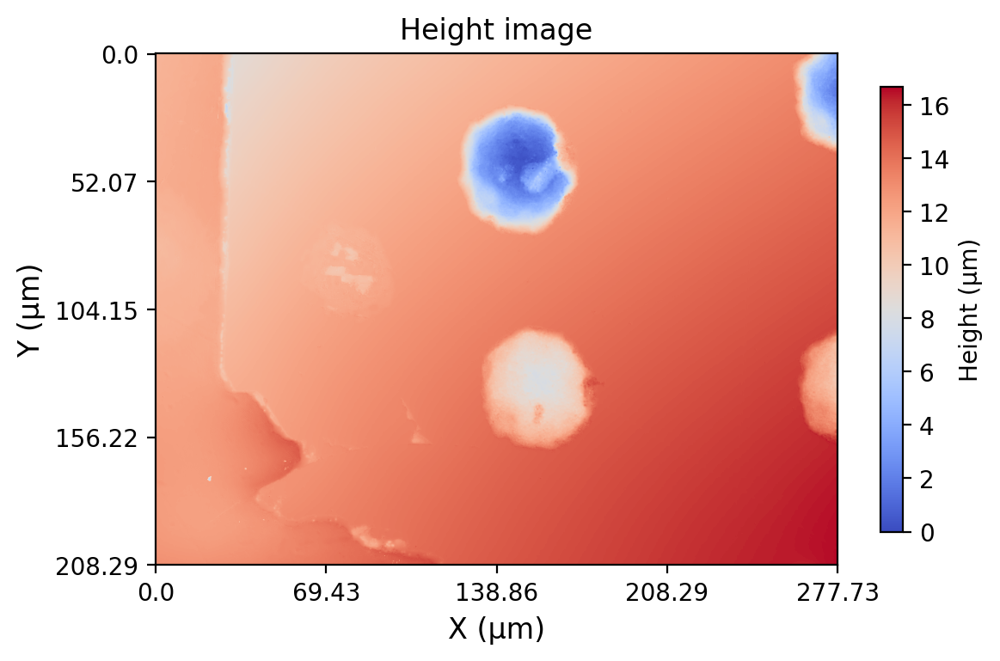

In [15]:
# display the height data as an image
ax = plot_Vk4_height(depthpro_60um_100E_10_20shots_Vk4)
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

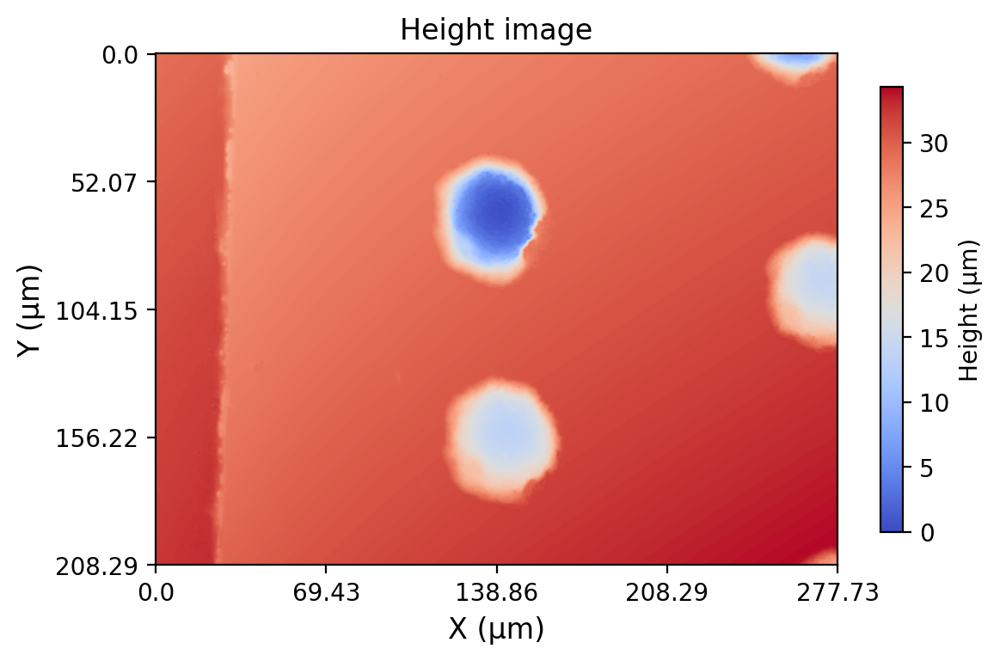

In [16]:
# display the height data as an image
ax = plot_Vk4_height(depthpro_60um_100E_30_50shots_Vk4)
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

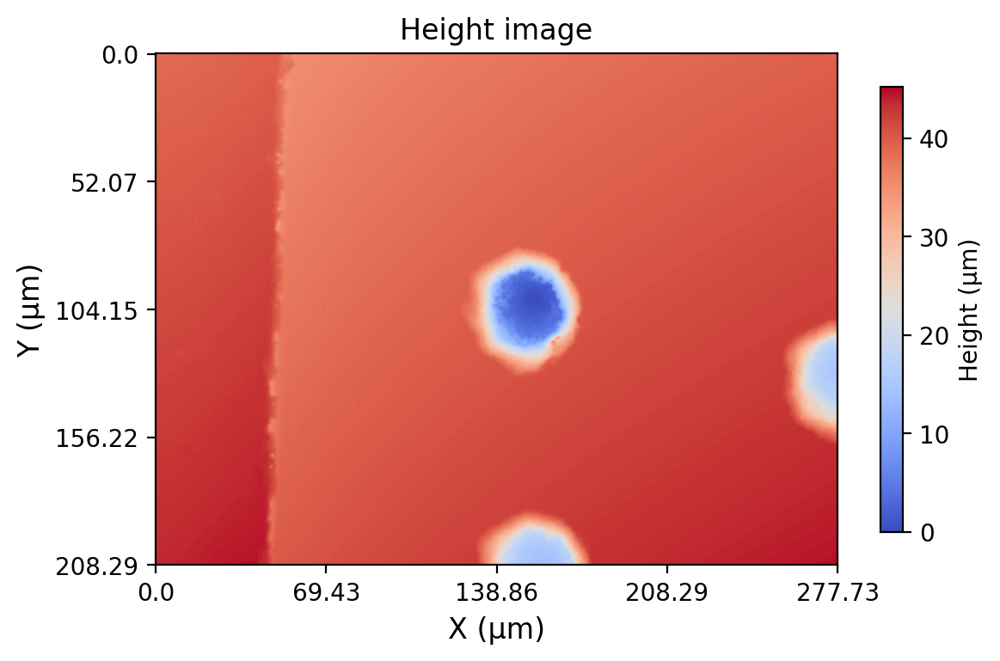

In [17]:
# display the height data as an image
ax = plot_Vk4_height(depthpro_60um_100E_70_shots_Vk4)
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

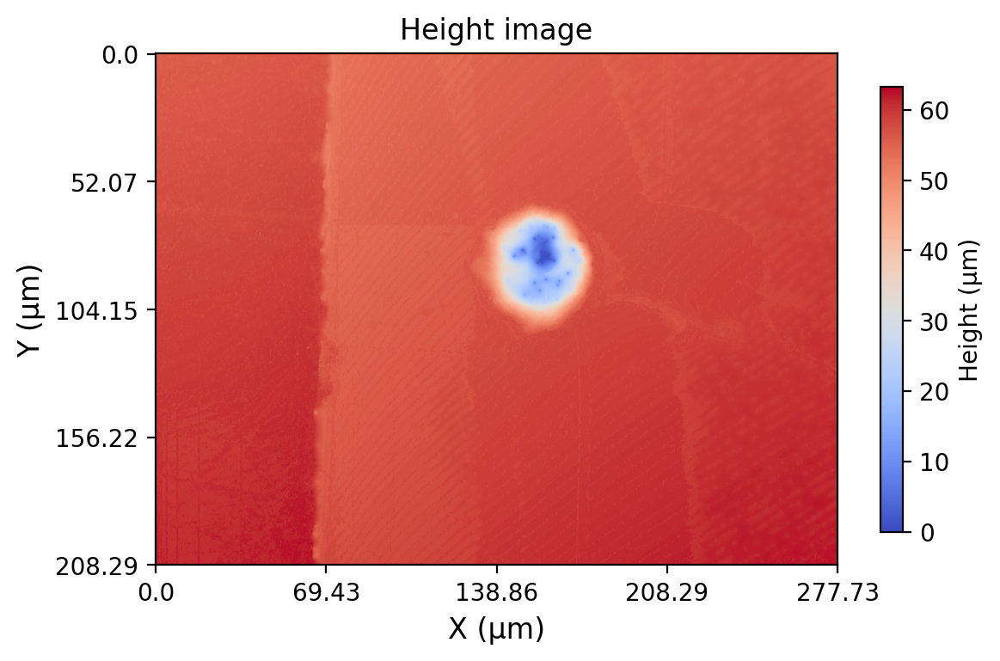

In [18]:
# display the height data as an image
ax = plot_Vk4_height(depthpro_60um_100E_90_shots_Vk4)
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

## base plane selection

In [19]:
def baseplane_filter(Vk4File, percentage):
    height_data = Vk4File['img_height_data']['data']
    baseplane = np.where(height_data < np.percentile(height_data, percentage), np.nan, height_data)
    baseplane = baseplane.reshape(Vk4File['img_height_data']['height'], Vk4File['img_height_data']['width'])
    baseplane_fit = fit_least_squares_plane(baseplane)
    Vk4File['baseplane'] = baseplane
    Vk4File['baseplane_fit'] = baseplane_fit
    Vk4File['baseplane_subtracted'] = (height_data - baseplane_fit.flatten()).reshape(Vk4File['img_height_data']['height'], Vk4File['img_height_data']['width'])
    return Vk4File

def plot_baseplane(Vk4File):
    ax = plot_height_data(Vk4File['baseplane'], Vk4File['img_height_data']['width'], Vk4File['img_height_data']['height'])
    return ax

def plot_baseplane_fit(Vk4File):
    ax = plot_height_data(Vk4File['baseplane_fit'], Vk4File['img_height_data']['width'], Vk4File['img_height_data']['height'])
    return ax

In [35]:
depthpro_60um_100E_10_20shots_Vk4 = baseplane_filter(depthpro_60um_100E_10_20shots_Vk4, 60)
depthpro_60um_100E_30_50shots_Vk4 = baseplane_filter(depthpro_60um_100E_30_50shots_Vk4, 60)
depthpro_60um_100E_70_shots_Vk4_cropped = baseplane_filter(depthpro_60um_100E_70_shots_Vk4_cropped, 60)
depthpro_60um_100E_90_shots_Vk4_cropped = baseplane_filter(depthpro_60um_100E_90_shots_Vk4_cropped, 60)

### 60µm 100% E 10-20 shots base plane

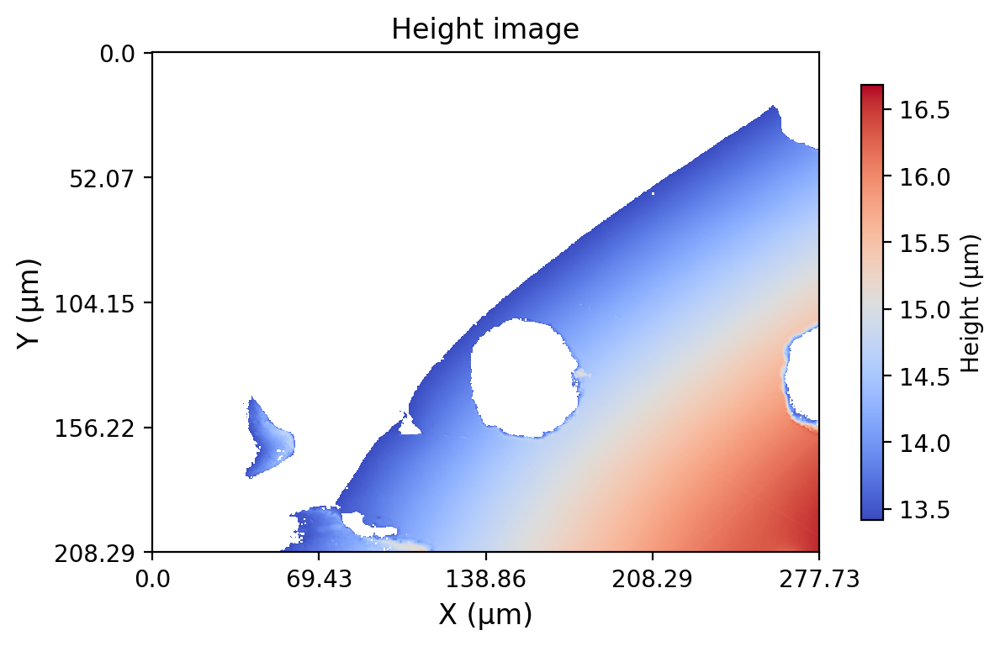

In [21]:
ax = plot_baseplane(depthpro_60um_100E_10_20shots_Vk4)
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

### 60µm 100% E 30-50 shots base plane

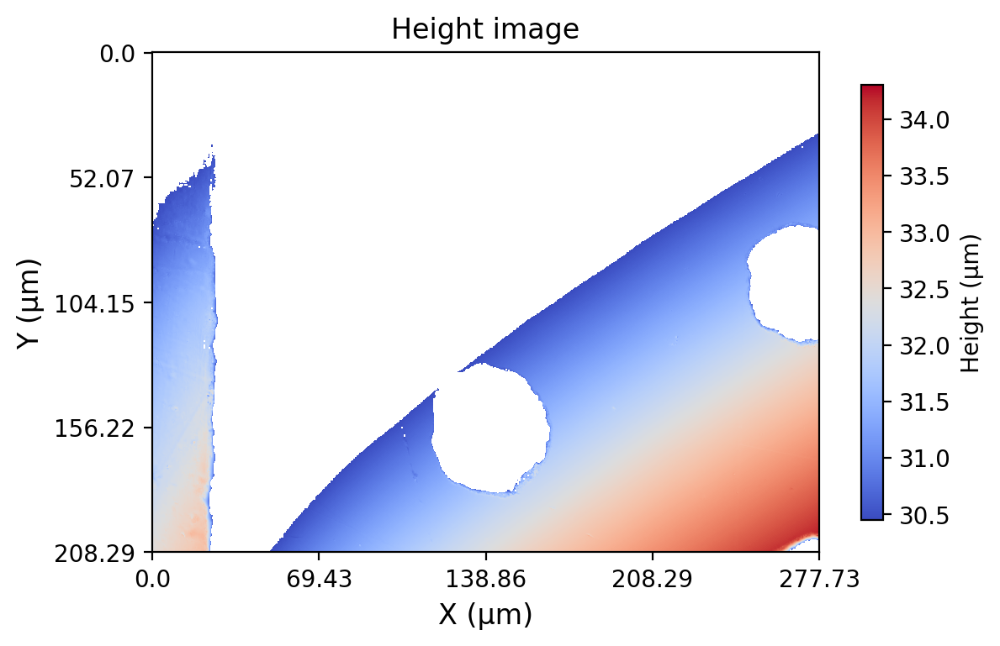

In [22]:
ax = plot_baseplane(depthpro_60um_100E_30_50shots_Vk4)
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

### 60µm 100% E 70 shots base plane

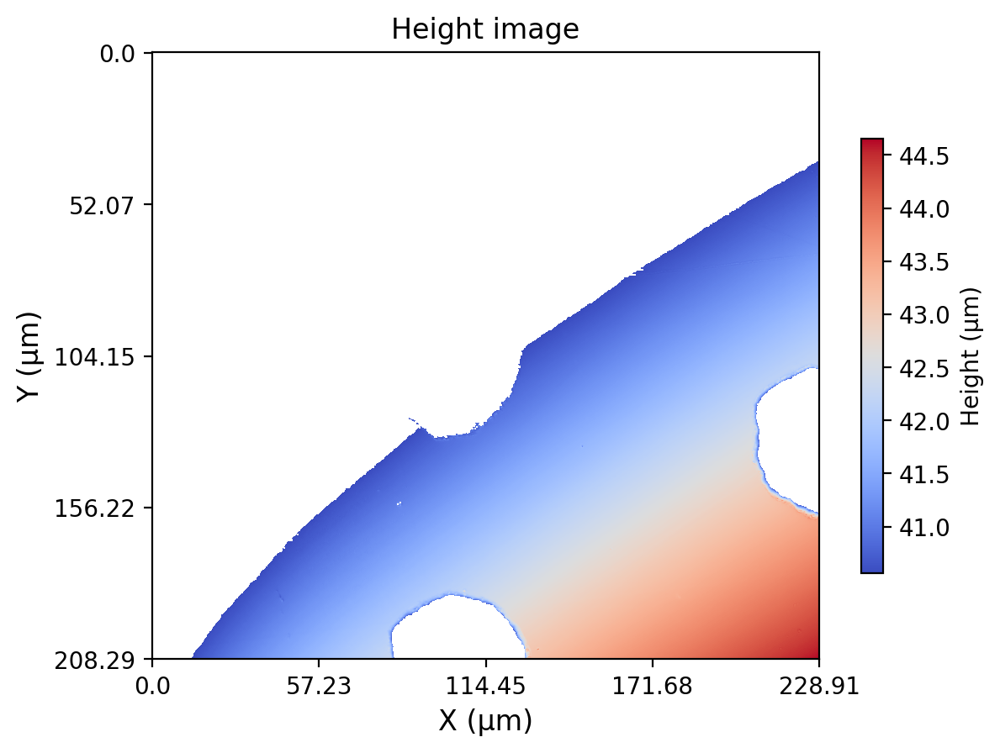

In [36]:
ax = plot_baseplane(depthpro_60um_100E_70_shots_Vk4_cropped)
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

### 60µm 100% E 90 shots base plane

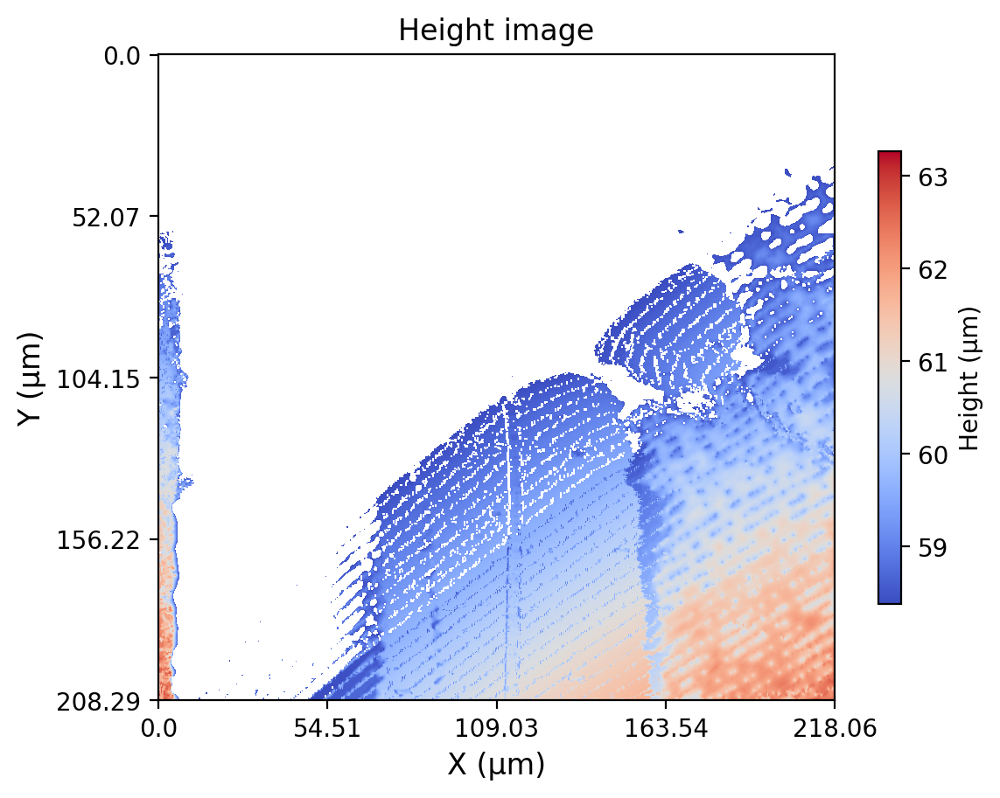

In [37]:
ax = plot_baseplane(depthpro_60um_100E_90_shots_Vk4_cropped)
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

## base plane fitting

### 60µm 100% E 10-20 shots base plane fit

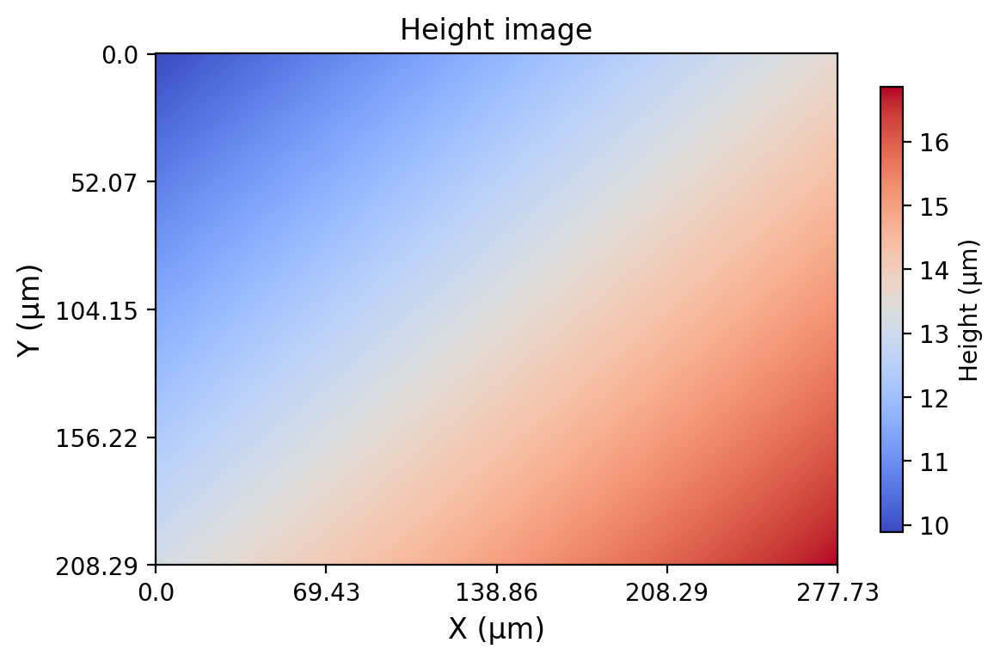

In [38]:
ax = plot_baseplane_fit(depthpro_60um_100E_10_20shots_Vk4)
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

### 60µm 100% E 30-50 shots base plane fit

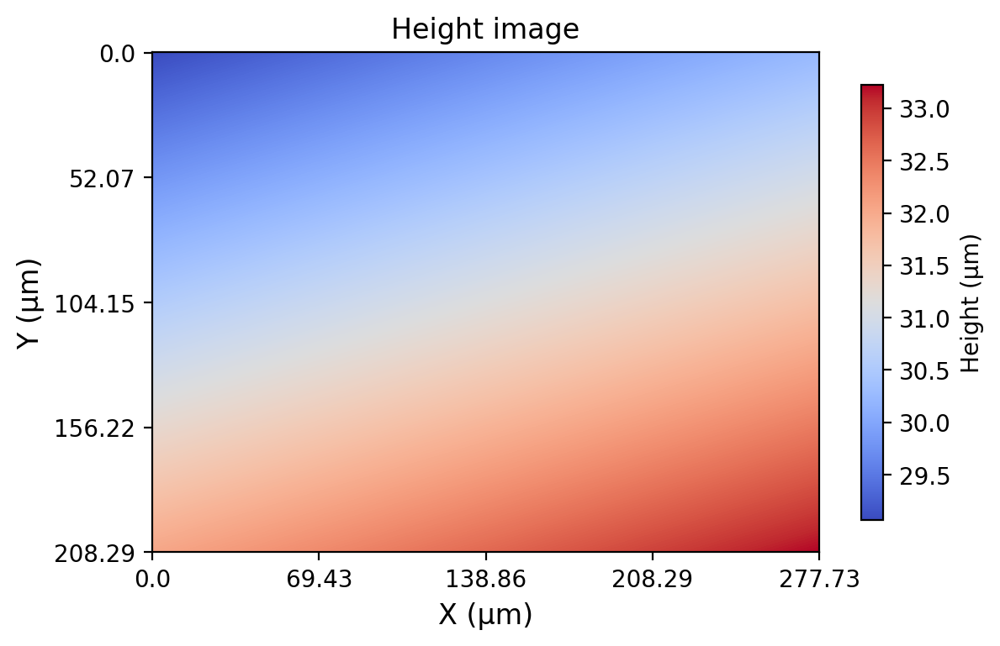

In [39]:
ax = plot_baseplane_fit(depthpro_60um_100E_30_50shots_Vk4)
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

### 60µm 100% E 70 shots base plane fit

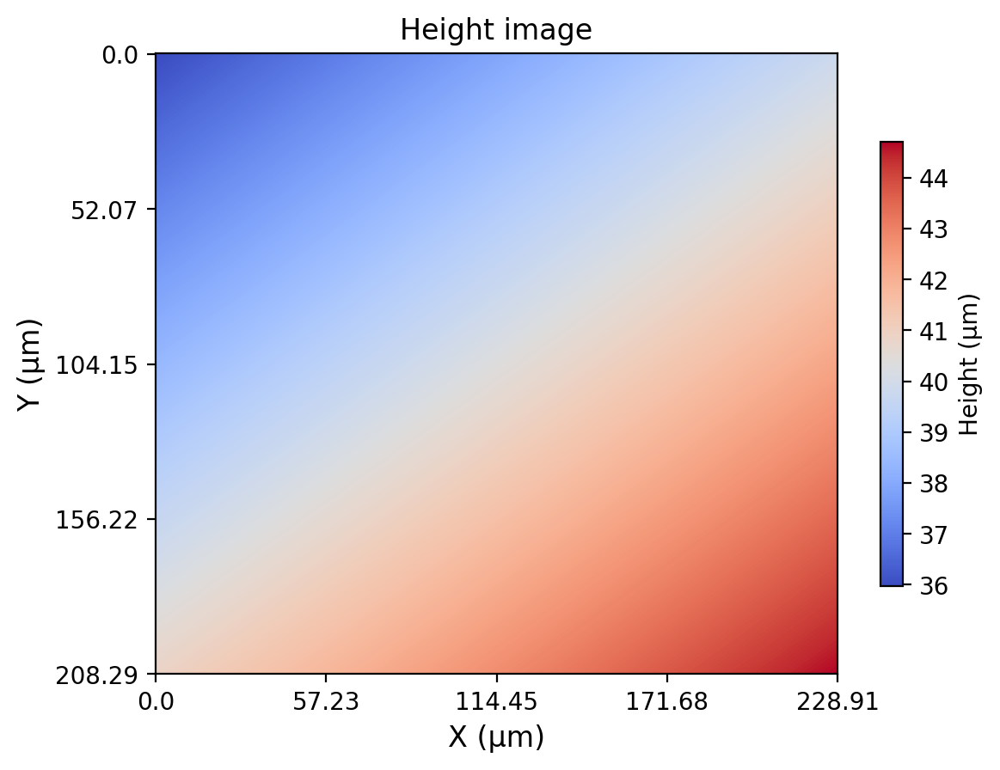

In [41]:
ax = plot_baseplane_fit(depthpro_60um_100E_70_shots_Vk4_cropped)
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

### 60µm 100% E 90 shots base plane fit

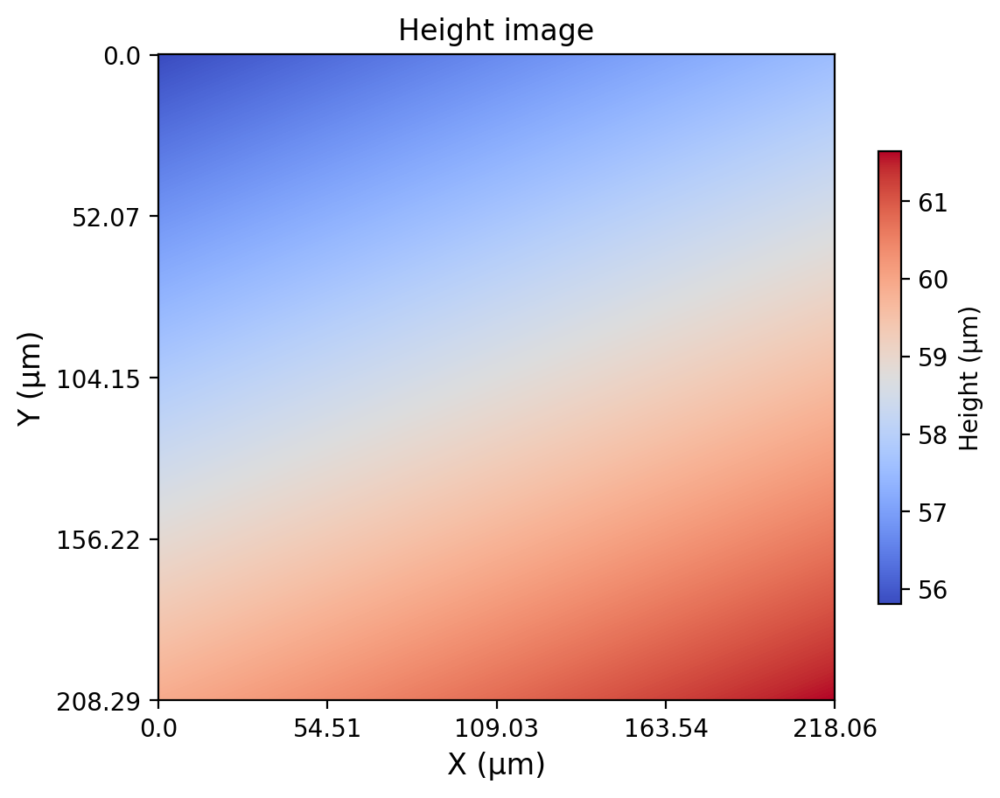

In [42]:
ax = plot_baseplane_fit(depthpro_60um_100E_90_shots_Vk4_cropped)
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

## base plane subtraction

### 60µm 100% E 10-20 shots tilt corrected

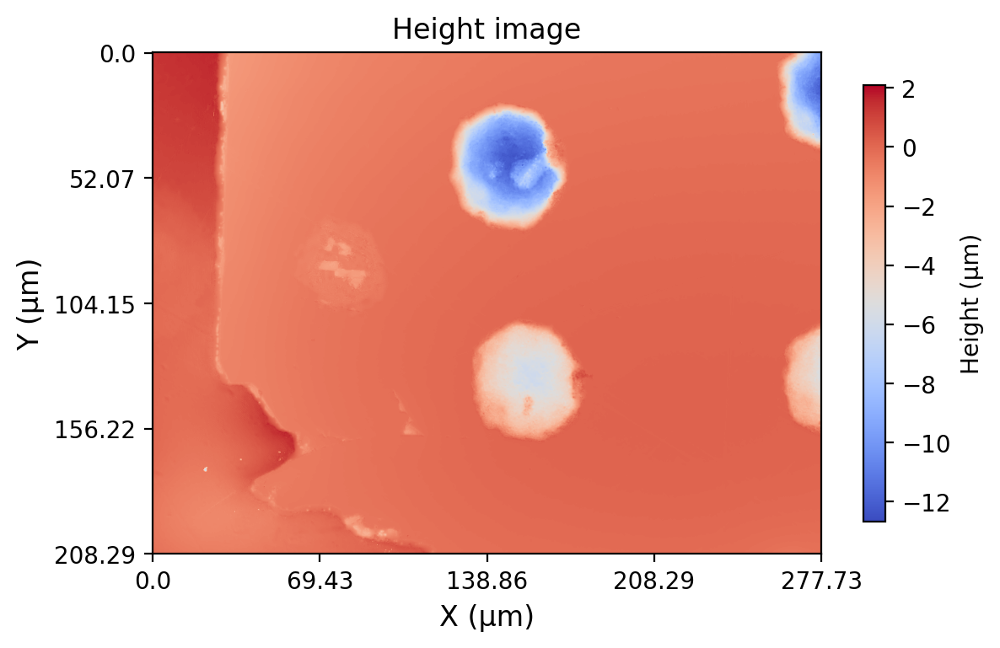

In [43]:
ax = plot_height_data(depthpro_60um_100E_10_20shots_Vk4['baseplane_subtracted'], 
                      depthpro_60um_100E_10_20shots_Vk4['img_height_data']['width'], 
                      depthpro_60um_100E_10_20shots_Vk4['img_height_data']['height'])
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

### 60µm 100% E 30-50 shots tilt corrected

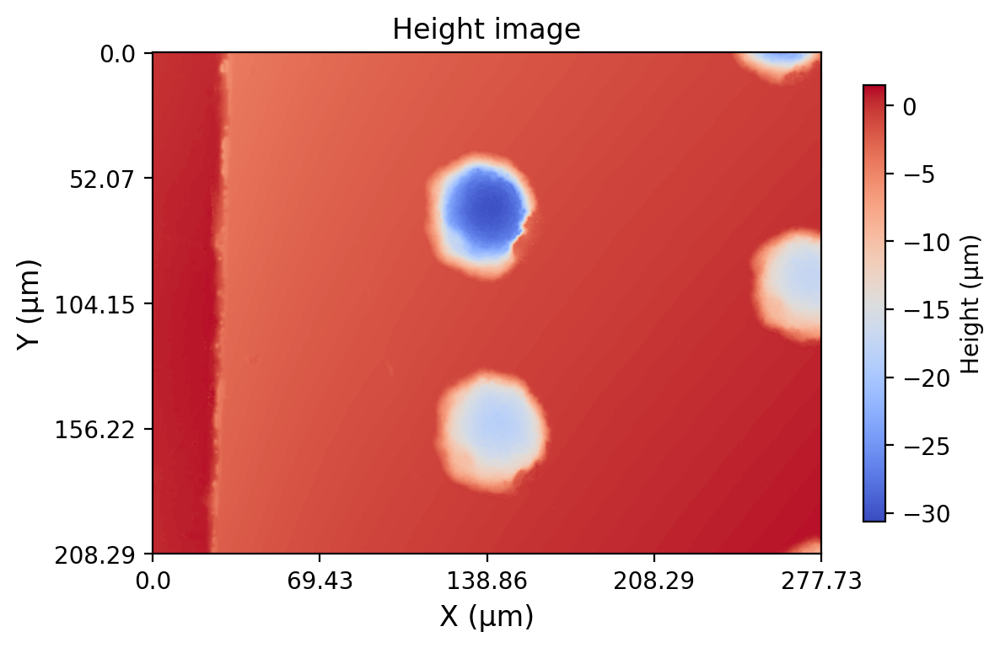

In [44]:
ax = plot_height_data(depthpro_60um_100E_30_50shots_Vk4['baseplane_subtracted'], 
                      depthpro_60um_100E_30_50shots_Vk4['img_height_data']['width'], 
                      depthpro_60um_100E_30_50shots_Vk4['img_height_data']['height'])
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

### 60µm 100% E 70 shots tilt corrected

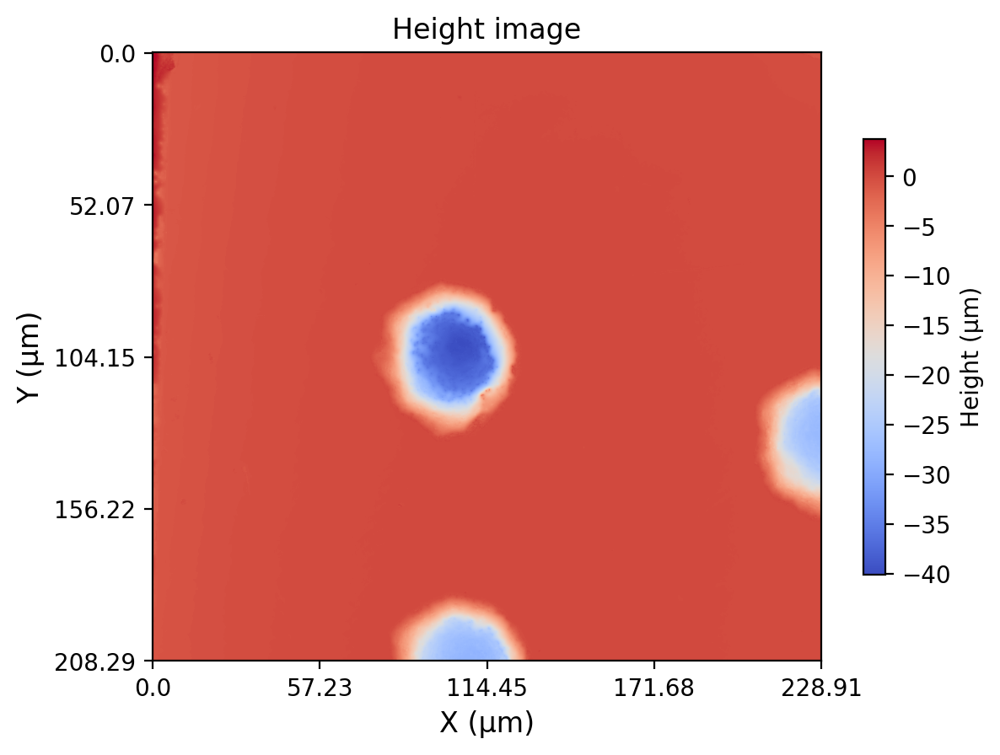

In [45]:
ax = plot_height_data(depthpro_60um_100E_70_shots_Vk4_cropped['baseplane_subtracted'], 
                      depthpro_60um_100E_70_shots_Vk4_cropped['img_height_data']['width'], 
                      depthpro_60um_100E_70_shots_Vk4_cropped['img_height_data']['height'])
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

### 60µm 100% E 90 shots tilt corrected

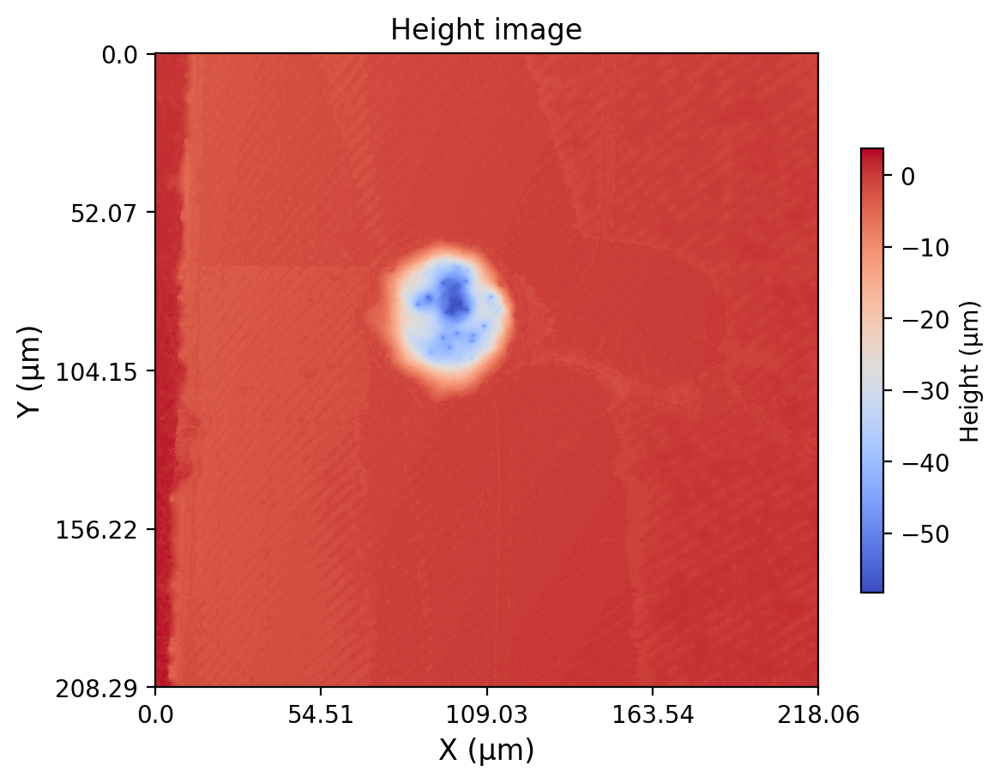

In [46]:
ax = plot_height_data(depthpro_60um_100E_90_shots_Vk4_cropped['baseplane_subtracted'], 
                      depthpro_60um_100E_90_shots_Vk4_cropped['img_height_data']['width'], 
                      depthpro_60um_100E_90_shots_Vk4_cropped['img_height_data']['height'])
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

## crop map to isolate individual drill holes

In [47]:
depthpro_60um_100E_10_20shots_Vk4['img_height_data']['width'], depthpro_60um_100E_10_20shots_Vk4['img_height_data']['height']

(1024, 768)

In [ ]:
depthpro_60um_100E_10shots = crop_Vk4File_map(depthpro_60um_100E_10_20shots_Vk4, 450, 700, 400, 600)
depthpro_60um_100E_20shots = crop_Vk4File_map(depthpro_60um_100E_10_20shots_Vk4, 450, 650, 50, 300)
depthpro_60um_100E_30shots = crop_Vk4File_map(depthpro_60um_100E_30_50shots_Vk4, 400, 630, 450, 700)
depthpro_60um_100E_50shots = crop_Vk4File_map(depthpro_60um_100E_30_50shots_Vk4, 400, 630, 120, 380)
depthpro_60um_100E_70shots = crop_Vk4File_map(depthpro_60um_100E_70_shots_Vk4_cropped, 260, 470, 270, 500)
depthpro_60um_100E_90shots = crop_Vk4File_map(depthpro_60um_100E_90_shots_Vk4_cropped, 250, 450, 200, 420)

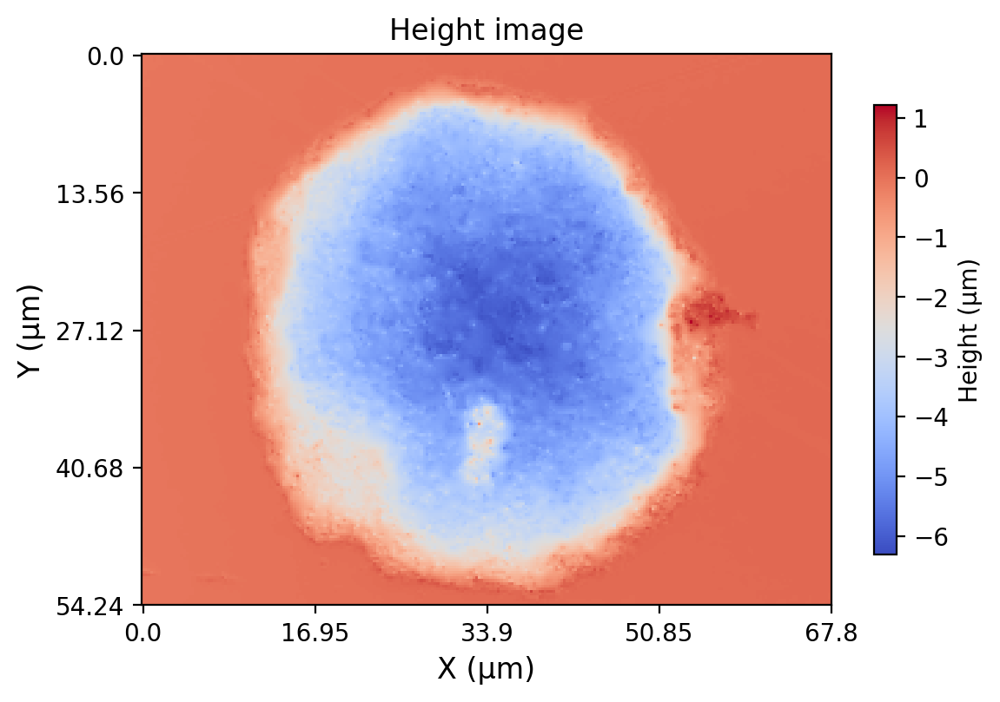

In [75]:
ax = plot_Vk4_height(depthpro_60um_100E_10shots, data_type='baseplane_subtracted')
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

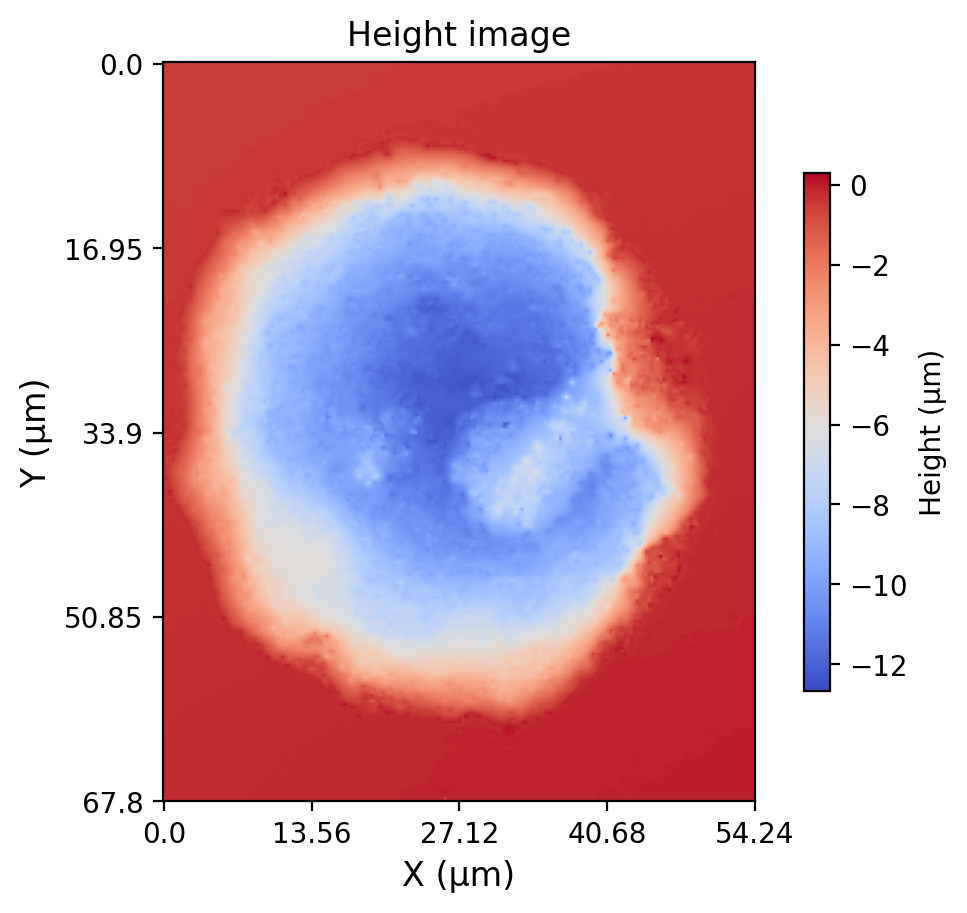

In [76]:
ax = plot_Vk4_height(depthpro_60um_100E_20shots, data_type='baseplane_subtracted')
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

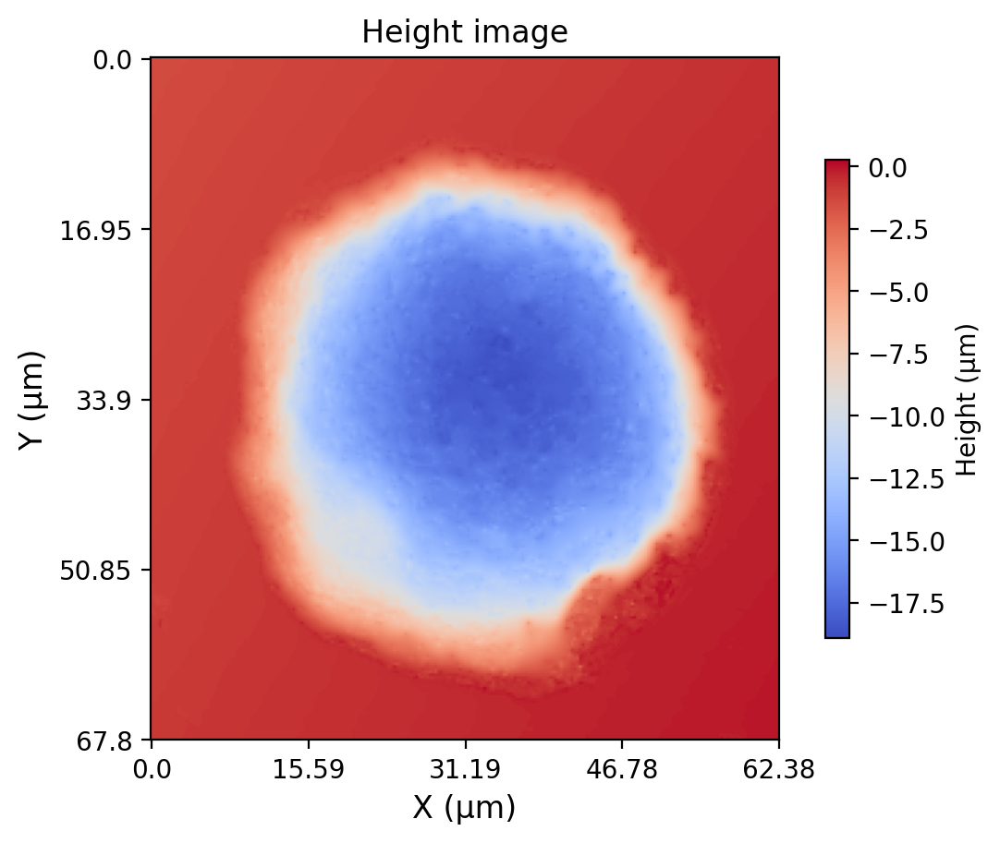

In [103]:
ax = plot_Vk4_height(depthpro_60um_100E_30shots, data_type='baseplane_subtracted')
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

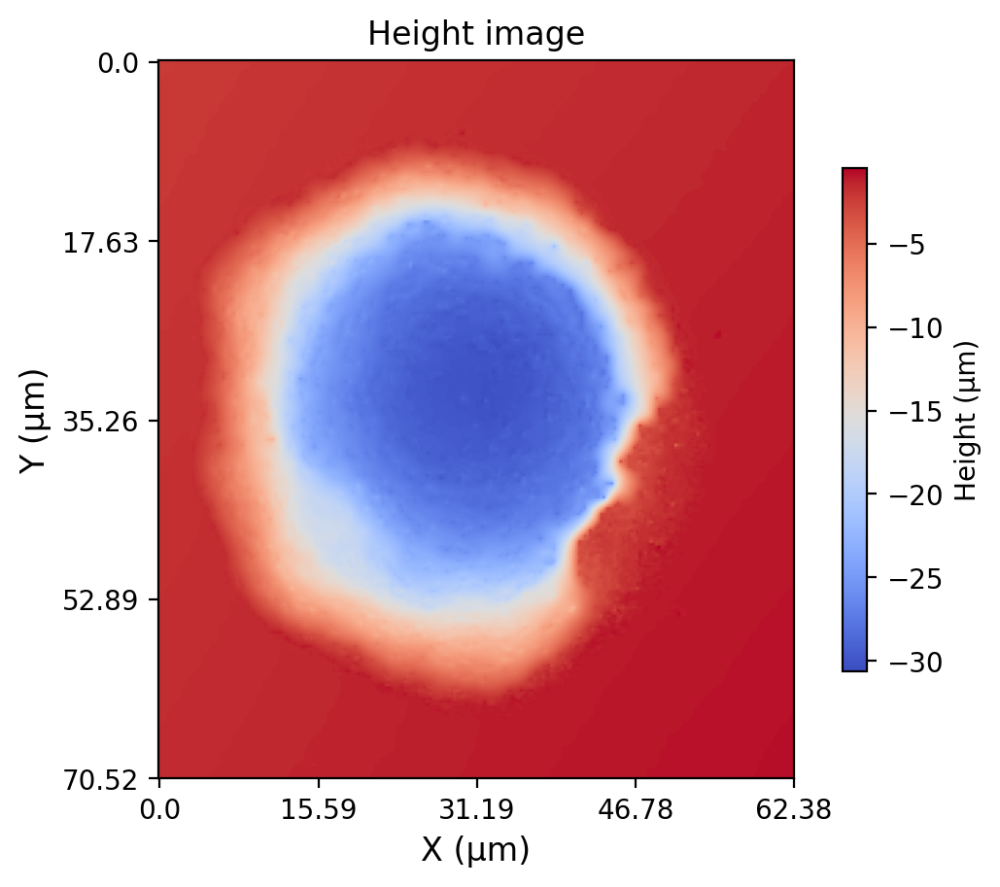

In [101]:
ax = plot_Vk4_height(depthpro_60um_100E_50shots, data_type='baseplane_subtracted')
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

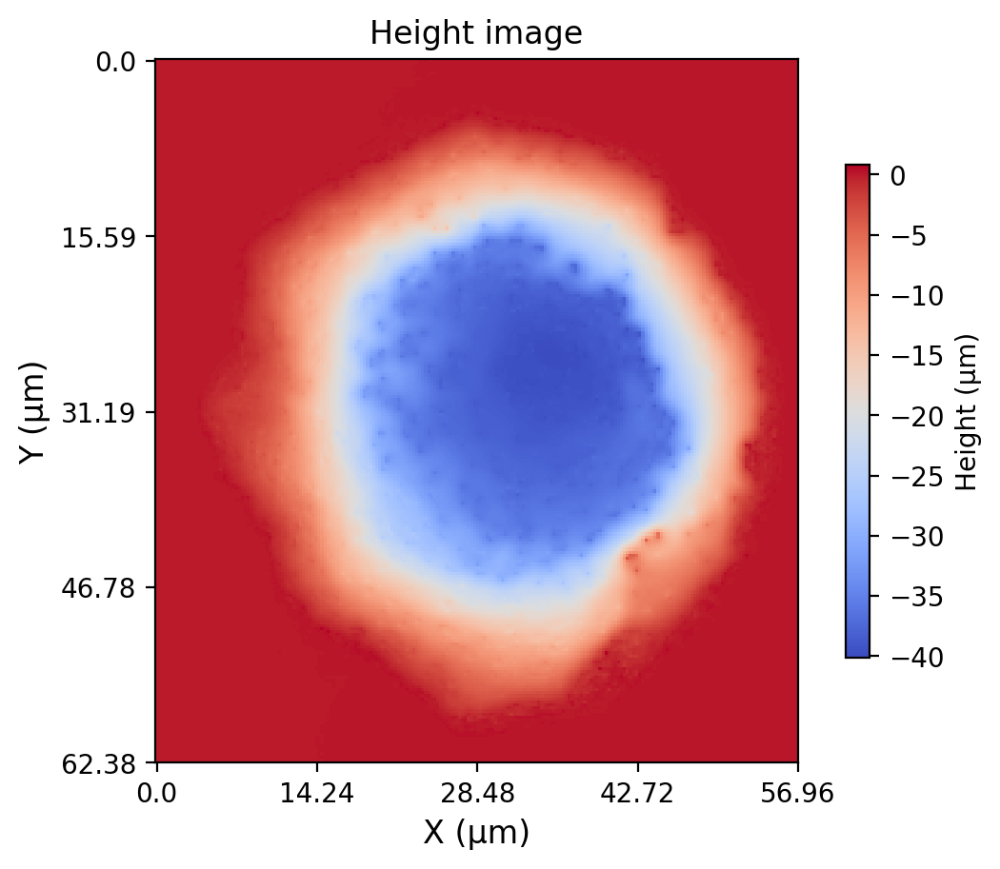

In [126]:
ax = plot_Vk4_height(depthpro_60um_100E_70shots, data_type='baseplane_subtracted')
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

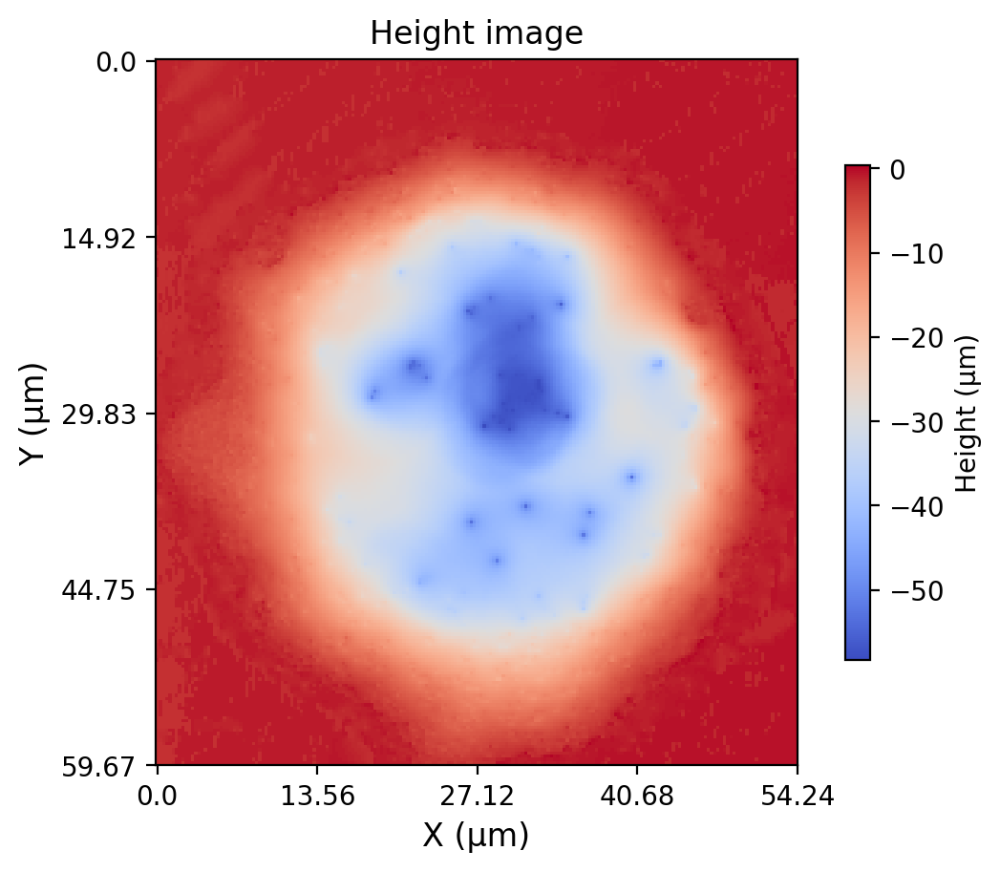

In [138]:
ax = plot_Vk4_height(depthpro_60um_100E_90shots, data_type='baseplane_subtracted')
plt.colorbar(ax.get_images()[0], ax=ax, label='Height (µm)', orientation='vertical', shrink=0.7)
plt.show()

## Plot the final cropped maps in 3D with Plotly

In [194]:
# plot 3D height data with plotly
def plot_3D_height(Vk4File, data_type='original', colorscale='RdBu_r'):
    if data_type == 'original':
        img_array = Vk4File['img_height_data']['data']
    elif data_type == 'baseplane':
        img_array = Vk4File['baseplane']
    elif data_type == 'baseplane_fit':
        img_array = Vk4File['baseplane_fit']
    elif data_type == 'baseplane_subtracted':
        img_array = Vk4File['baseplane_subtracted']
    else:
        raise ValueError('data_type must be either "original", "baseplane", "baseplane_fit", or "baseplane_subtracted"')
    
    img_width = Vk4File['img_height_data']['width']
    img_height = Vk4File['img_height_data']['height']
    calibration = Vk4File['measurement_conditions']['x_length_per_pixel']
    x = np.linspace(0, img_width*calibration/1e6, img_width)
    y = np.linspace(0, img_height*calibration/1e6, img_height)
    X, Y = np.meshgrid(x, y)
    Z = img_array.reshape(img_height, img_width)
    fig = go.Figure(data=[go.Surface(z=Z, x=X, y=Y, colorscale=colorscale)], layout=go.Layout(
        title='3D Height image',
        autosize=False,
        width=600,
        height=600,
        scene_aspectmode='data'
    ))
    return fig


### 60µm 100% E 10 shots 3D plot

In [202]:
fig=plot_3D_height(depthpro_60um_100E_10shots, data_type='baseplane_subtracted')
fig.write_html("depthpro_60um_100E_10shots.html")
fig

### 60µm 100% E 20 shots 3D plot

In [207]:
fig=plot_3D_height(depthpro_60um_100E_20shots, data_type='baseplane_subtracted')
fig.write_html("depthpro_60um_100E_20shots.html")
fig

### 60µm 100% E 30 shots 3D plot

In [210]:
fig=plot_3D_height(depthpro_60um_100E_30shots, data_type='baseplane_subtracted')
fig.write_html("depthpro_60um_100E_30shots.html")
fig

### 60µm 100% E 50 shots 3D plot

In [209]:
fig=plot_3D_height(depthpro_60um_100E_50shots, data_type='baseplane_subtracted')
fig.write_html("depthpro_60um_100E_50shots.html")
fig

### 60µm 100% E 70 shots 3D plot

In [204]:
fig=plot_3D_height(depthpro_60um_100E_70shots, data_type='baseplane_subtracted')
fig.write_html("depthpro_60um_100E_70shots.html")
fig

### 60µm 100% E 90 shots 3D plot

In [203]:
fig=plot_3D_height(depthpro_60um_100E_90shots, data_type='baseplane_subtracted')
fig.write_html("depthpro_60um_100E_90shots.html")
fig

## Plot shots vs. height distributions

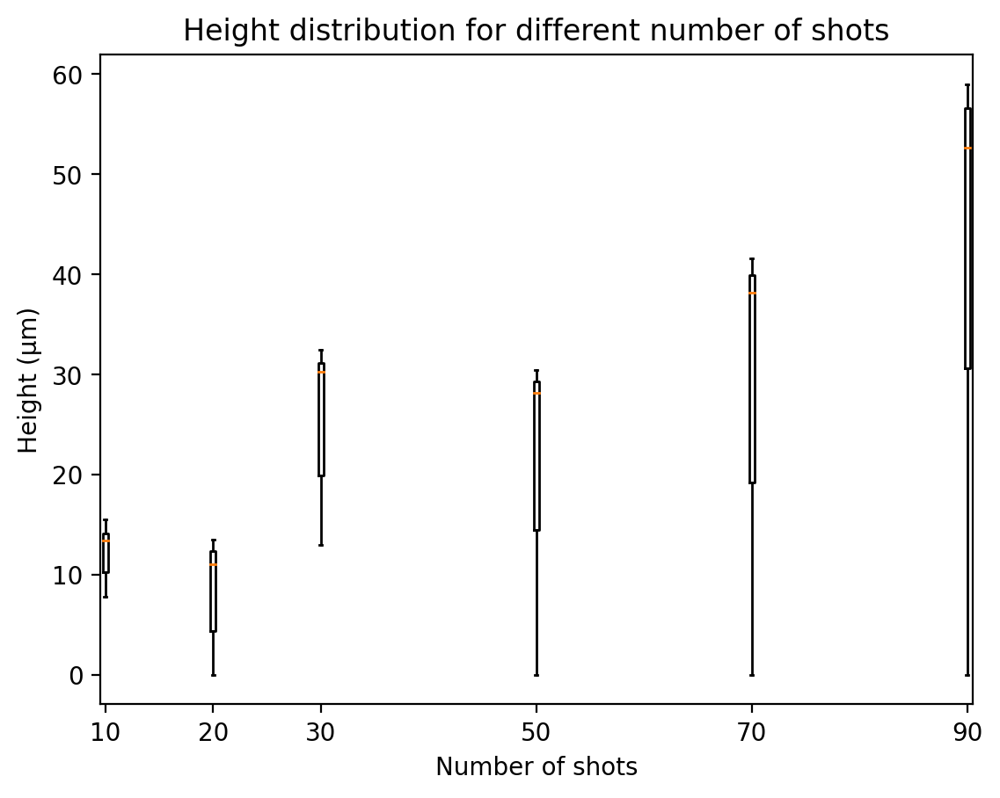

In [140]:
shot_nums = [10, 20, 30, 50, 70, 90]

plt.figure()
# make discrete y axis plot with shot numbers, and plot distribution of heights on the x axis
plt.boxplot([depthpro_60um_100E_10shots['img_height_data']['data'], 
             depthpro_60um_100E_20shots['img_height_data']['data'], 
             depthpro_60um_100E_30shots['img_height_data']['data'], 
             depthpro_60um_100E_50shots['img_height_data']['data'], 
             depthpro_60um_100E_70shots['img_height_data']['data'], 
             depthpro_60um_100E_90shots['img_height_data']['data']],
            positions=shot_nums)
plt.xlabel('Number of shots')
plt.ylabel('Height (µm)')
plt.title('Height distribution for different number of shots')
plt.show()

## volume calculation

In [142]:
def pit_vol_calc(Vk4File, base_subtraction = None, data_type='baseplane_subtracted'):
    '''calcualte pit volume'''
    if data_type == 'original':
        height_data = Vk4File['img_height_data']['data']
    elif data_type == 'baseplane':
        height_data = Vk4File['baseplane']
    elif data_type == 'baseplane_fit':
        height_data = Vk4File['baseplane_fit']
    elif data_type == 'baseplane_subtracted':
        height_data = Vk4File['baseplane_subtracted']
    else:
        raise ValueError('data_type must be either "original", "baseplane", "baseplane_fit", or "baseplane_subtracted"')
    if base_subtraction is not None:
        height_data = np.where(height_data > base_subtraction, np.nan, height_data)
    pit_volume = np.abs(np.nansum(height_data))
    return pit_volume

In [144]:
# now let's calculate the volume below the surface
depthpro_60um_100E_10shots_vol = pit_vol_calc(depthpro_60um_100E_10shots, 0, 'baseplane_subtracted')
depthpro_60um_100E_20shots_vol = pit_vol_calc(depthpro_60um_100E_20shots, 0, 'baseplane_subtracted')
depthpro_60um_100E_30shots_vol = pit_vol_calc(depthpro_60um_100E_30shots, 0, 'baseplane_subtracted')
depthpro_60um_100E_50shots_vol = pit_vol_calc(depthpro_60um_100E_50shots, 0, 'baseplane_subtracted')
depthpro_60um_100E_70shots_vol = pit_vol_calc(depthpro_60um_100E_70shots, 0, 'baseplane_subtracted')
depthpro_60um_100E_90shots_vol = pit_vol_calc(depthpro_60um_100E_90shots, 0, 'baseplane_subtracted')

print(f"Volume below the surface: {depthpro_60um_100E_10shots_vol:.2f} µm³")
print(f"Volume below the surface: {depthpro_60um_100E_20shots_vol:.2f} µm³")
print(f"Volume below the surface: {depthpro_60um_100E_30shots_vol:.2f} µm³")
print(f"Volume below the surface: {depthpro_60um_100E_50shots_vol:.2f} µm³")
print(f"Volume below the surface: {depthpro_60um_100E_70shots_vol:.2f} µm³")
print(f"Volume below the surface: {depthpro_60um_100E_90shots_vol:.2f} µm³")


Volume below the surface: 87413.76 µm³
Volume below the surface: 198878.29 µm³
Volume below the surface: 329323.07 µm³
Volume below the surface: 520024.14 µm³
Volume below the surface: 520969.62 µm³
Volume below the surface: 622741.47 µm³


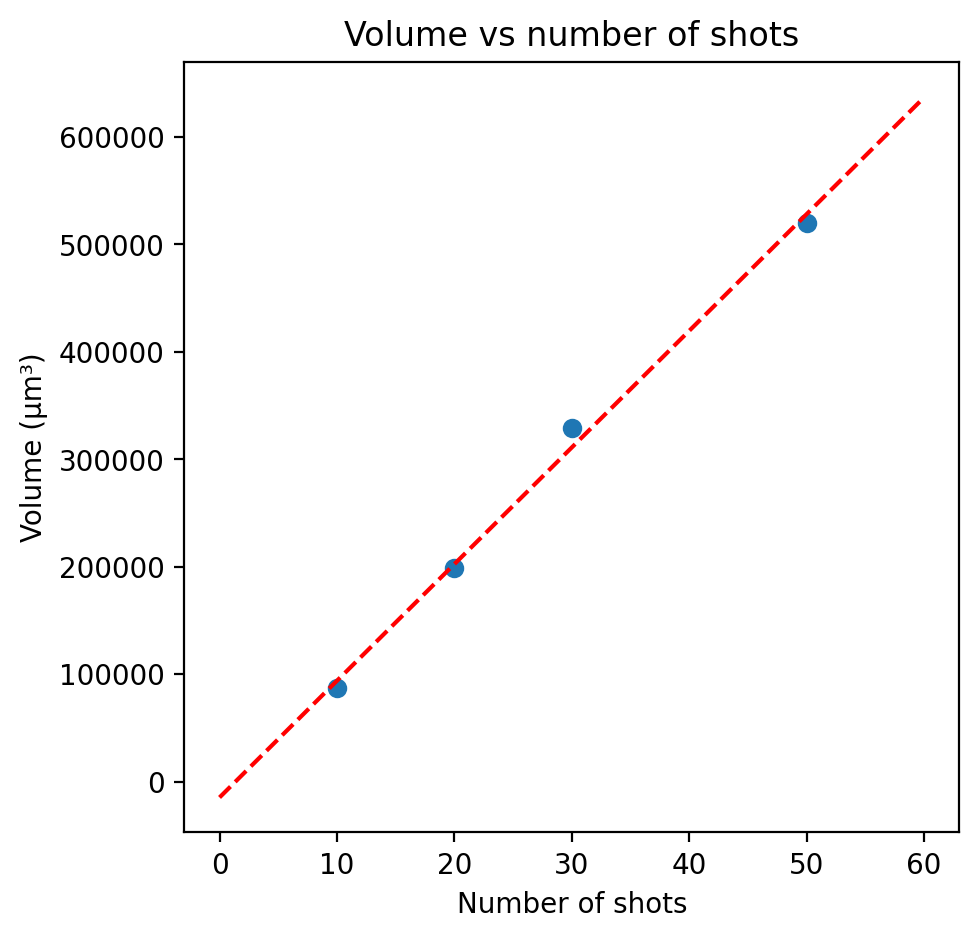

In [211]:
# let's fit a linear regression model to the data

X = [10, 20, 30, 50]
y = np.array([depthpro_60um_100E_10shots_vol, depthpro_60um_100E_20shots_vol, depthpro_60um_100E_30shots_vol, depthpro_60um_100E_50shots_vol])

m,b = np.polyfit(X, y, 1)
poly1d_fn = np.poly1d((m,b))

x = np.linspace(0, 60, 100)

plt.figure(figsize=(5,5))
plt.scatter(X, y)
plt.plot(x, poly1d_fn(x), ls='--', color='red')
plt.xlabel('Number of shots')
plt.ylabel('Volume (µm³)')
plt.title('Volume vs number of shots')
plt.show()

In [161]:
print('The drill rate of the laser on the Durango apatite crystal is:', round(m), 'µm³/shot')
print('The drill depth rate of the laser on the Durango apatite crystal is:', round(m/(np.pi*60**2), 2), 'µm³/shot')

The drill rate of the laser on the Durango apatite crystal is: 10860 µm³/shot
The drill depth rate of the laser on the Durango apatite crystal is: 0.96 µm³/shot


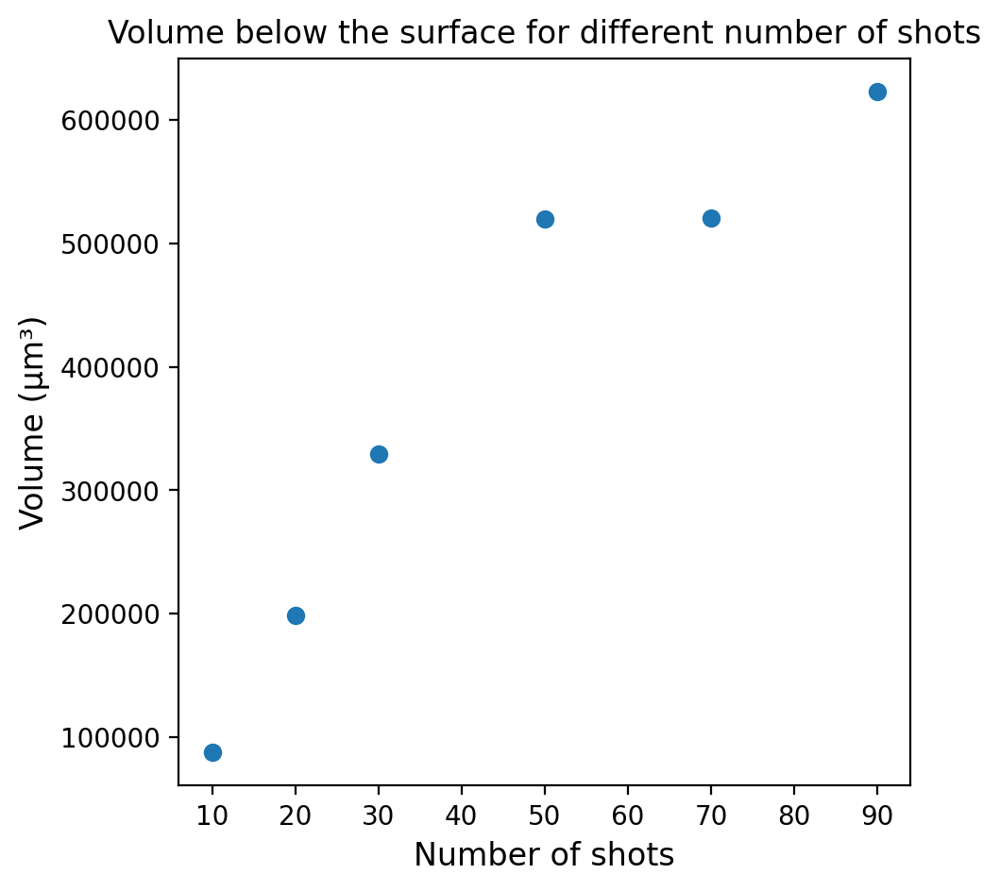

In [147]:
plt.figure(figsize=(5,5))
plt.scatter([10, 20, 30, 50, 70, 90], [depthpro_60um_100E_10shots_vol,
                                       depthpro_60um_100E_20shots_vol,
                                       depthpro_60um_100E_30shots_vol, 
                                       depthpro_60um_100E_50shots_vol, 
                                       depthpro_60um_100E_70shots_vol, 
                                       depthpro_60um_100E_90shots_vol])
plt.xlabel('Number of shots', fontsize=12)
plt.ylabel('Volume (µm³)', fontsize=12)
plt.title('Volume below the surface for different number of shots')
plt.show()